# Configurable Colorization Experiment: Model B – cGAN + L1 (Pix2Pix-Style Baseline)
## Comparative Study of U-Net and Conditional GAN with Configurable Loss Functions

This notebook implements a **configurable deep-learning framework for image colorization**.  
Given a grayscale input image, the objective is to predict plausible chrominance information and reconstruct a full-color image.

Formally, we learn a mapping
$$
G_\theta : \mathbb{R}^{1 \times H \times W} \rightarrow \mathbb{R}^{2 \times H \times W},
$$
where:

- The **input** is the luminance channel $L$ of an image in the CIE Lab color space.
- The **output** is the pair of chrominance channels $(a, b)$, predicted in normalized form.

The framework supports multiple **experiment configurations (Models A–F and ablation variants)** that differ in:

1. **Architecture**
   - U-Net generator (always used).
   - Optional PatchGAN discriminator (for conditional GAN setups).

2. **Loss components**
   - Pixel-wise **$L_1$ loss** on chrominance channels.
   - **Adversarial loss** (conditional GAN).
   - **Perceptual loss** based on VGG16 features.

3. **Loss weights**
   - Configurable coefficients $\lambda_{\text{L1}}$ and $\lambda_{\text{perc}}$ for each model.

Each configuration corresponds to a specific combination of these elements, enabling controlled comparisons of:

- Pure regression vs. GAN-based models.
- The impact of perceptual loss on visual quality.
- Sensitivity to different loss weightings.

The notebook provides a complete project-style pipeline:

- **Experiment configuration** (Models A–F and ablation variants around Model C).
- **Data loading and preprocessing** in the CIE Lab color space.
- **Model definition** (U-Net generator, PatchGAN discriminator, VGG16 perceptual module).
- **Training and validation loops** with a linear-decay learning rate schedule.
- **Quantitative evaluation** using PSNR, SSIM, CIEDE2000, and LPIPS.
- **Qualitative visualization** of colorized outputs and training curves.

This design makes the notebook suitable as a **formal experimental framework** for systematic study of image colorization methods.

### Model B – cGAN + L1 (Pix2Pix-Style Baseline)

**Configuration summary**

- `MODEL_ID`: `B`
- Description: cGAN + L1 (pix2pix-style)
- Generator: U-Net
- Discriminator: PatchGAN (`USE_GAN = True`)
- Loss components:
  - $L_1$ loss on chrominance channels (`USE_L1 = True`)
  - Adversarial loss (`USE_GAN = True`)
  - No perceptual loss (`USE_PERCEPTUAL = False`)
- Loss weights:
  - $\lambda_{\text{L1}} = 100.0$
  - $\lambda_{\text{perc}} = 0.0$

**Generator objective**

For Model B, the generator objective combines $L_1$ regression and adversarial loss:

$$
\mathcal{L}_G^{(B)}
= \lambda_{\text{L1}} \, \mathcal{L}_{\text{L1}}
+ \mathcal{L}_{\text{adv}},
$$

with:

$$
\mathcal{L}_{\text{L1}}
= \mathbb{E}_{(L,ab)} \left[ \| G_\theta(L) - ab \|_1 \right],
$$

$$
\mathcal{L}_{\text{adv}}
= - \mathbb{E}_{L} \left[ \log \sigma(D_\phi(L, G_\theta(L))) \right],
$$

and $\lambda_{\text{L1}} = 100.0$.

**Role in experimental comparison**

Model B is a **pix2pix-style baseline**, showing the effect of adding a PatchGAN discriminator on top of pure $L_1$ regression:

- Expected to yield sharper and more locally realistic colorizations compared to Model A.
- Does **not** yet incorporate perceptual loss, so any improvement over Model A can be attributed primarily to adversarial training.


In [1]:
# ============================================================
# EXPERIMENT CONFIGURATION
# ============================================================

# Model ID: Choose from 'A', 'B', 'C', 'D', 'E', 'F'
MODEL_ID = "B"

# Training hyperparameters
BATCH_SIZE = 64
IMG_SIZE = 256
EPOCHS = 50
SAVE_INTERVAL = 10
LEARNING_RATE = 2e-4

# Random seed for reproducibility
SEED = 42

# ============================================================
# MODEL CONFIGURATIONS
# ============================================================
# Model A: U-Net + L1 (pure regression)
# Model B: cGAN + L1 (pix2pix-style)
# Model C: cGAN + L1 + Perceptual (main proposed model)
# Model D: U-Net + Perceptual (no L1, no GAN)
# Model E: U-Net + L1 + Perceptual (no GAN)
# Model F: cGAN + Perceptual (no L1)
# ============================================================

MODEL_CONFIGS = {
    "A": {
        "description": "U-Net + L1 (pure regression)",
        "USE_GAN": False,
        "USE_L1": True,
        "USE_PERCEPTUAL": False,
        "LAMBDA_L1": 100.0,
        "LAMBDA_PERCEPTUAL": 0.0,
    },
    "B": {
        "description": "cGAN + L1 (pix2pix-style)",
        "USE_GAN": True,
        "USE_L1": True,
        "USE_PERCEPTUAL": False,
        "LAMBDA_L1": 100.0,
        "LAMBDA_PERCEPTUAL": 0.0,
    },
    "C": {
        "description": "cGAN + L1 + Perceptual (main proposed model)",
        "USE_GAN": True,
        "USE_L1": True,
        "USE_PERCEPTUAL": True,
        "LAMBDA_L1": 100.0,
        "LAMBDA_PERCEPTUAL": 10.0,
    },
    "D": {
        "description": "U-Net + Perceptual (no L1, no GAN)",
        "USE_GAN": False,
        "USE_L1": False,
        "USE_PERCEPTUAL": True,
        "LAMBDA_L1": 0.0,
        "LAMBDA_PERCEPTUAL": 10.0,
    },
    "E": {
        "description": "U-Net + L1 + Perceptual (no GAN)",
        "USE_GAN": False,
        "USE_L1": True,
        "USE_PERCEPTUAL": True,
        "LAMBDA_L1": 100.0,
        "LAMBDA_PERCEPTUAL": 10.0,
    },
    "F": {
        "description": "cGAN + Perceptual (no L1)",
        "USE_GAN": True,
        "USE_L1": False,
        "USE_PERCEPTUAL": True,
        "LAMBDA_L1": 0.0,
        "LAMBDA_PERCEPTUAL": 10.0,
    },
    "C_L1_LOW": {
        "description": "cGAN + L1 + Perceptual (main proposed model with low L1 weight)",
        "USE_GAN": True,
        "USE_L1": True,
        "USE_PERCEPTUAL": True,
        "LAMBDA_L1": 50.0,  # 0.5 times the usual weight
        "LAMBDA_PERCEPTUAL": 10.0,
    },
    "C_L1_HIGH": {
        "description": "cGAN + L1 + Perceptual (main proposed model with high L1 weight)",
        "USE_GAN": True,
        "USE_L1": True,
        "USE_PERCEPTUAL": True,
        "LAMBDA_L1": 200.0,  # 2 times the usual weight
        "LAMBDA_PERCEPTUAL": 10.0,
    },
    "C_PERCEPTUAL_LOW": {
        "description": "cGAN + L1 + Perceptual (main proposed model with low Perceptual weight)",
        "USE_GAN": True,
        "USE_L1": True,
        "USE_PERCEPTUAL": True,
        "LAMBDA_L1": 100.0,
        "LAMBDA_PERCEPTUAL": 5.0,  # 0.5 times the usual weight
    },
    "C_PERCEPTUAL_HIGH": {
        "description": "cGAN + L1 + Perceptual (main proposed model with high Perceptual weight)",
        "USE_GAN": True,
        "USE_L1": True,
        "USE_PERCEPTUAL": True,
        "LAMBDA_L1": 100.0,
        "LAMBDA_PERCEPTUAL": 20.0,  # 2 times the usual weight
    },
}

# Load selected configuration
if MODEL_ID not in MODEL_CONFIGS:
    raise ValueError(f"Invalid MODEL_ID '{MODEL_ID}'. Choose from: {list(MODEL_CONFIGS.keys())}")

config = MODEL_CONFIGS[MODEL_ID]
USE_GAN = config["USE_GAN"]
USE_L1 = config["USE_L1"]
USE_PERCEPTUAL = config["USE_PERCEPTUAL"]
LAMBDA_L1 = config["LAMBDA_L1"]
LAMBDA_PERCEPTUAL = config["LAMBDA_PERCEPTUAL"]

# Display configuration
print("=" * 60)
print(f"MODEL {MODEL_ID}: {config['description']}")
print("=" * 60)
print(f"GAN:              {USE_GAN}")
print(f"L1 Loss:          {USE_L1} (λ₁ = {LAMBDA_L1})")
print(f"Perceptual Loss:  {USE_PERCEPTUAL} (λ₂ = {LAMBDA_PERCEPTUAL})")
print(f"Epochs:           {EPOCHS}")
print(f"Batch Size:       {BATCH_SIZE}")
print(f"Learning Rate:    {LEARNING_RATE}")
print("=" * 60)


MODEL B: cGAN + L1 (pix2pix-style)
GAN:              True
L1 Loss:          True (λ₁ = 100.0)
Perceptual Loss:  False (λ₂ = 0.0)
Epochs:           50
Batch Size:       64
Learning Rate:    0.0002


## Import Libraries

This section imports all external libraries required for the project.

### Core Utilities

- `glob` – for pattern-based file discovery (e.g. listing image files).
- `random` – for generic Python-level randomness (e.g. shuffling).
- `warnings` – to filter non-critical warnings (e.g. negative Z values in color conversions).
- `pathlib.Path` – for convenient and robust file path handling.

### Numerical Computing and Data Handling

- `numpy` (`np`) – numerical operations, array manipulation, and data conversion.
- `pandas` (`pd`) – tabular data handling (e.g. saving experiment results and histories to CSV).

### Deep Learning Framework (PyTorch)

- `torch` – core tensor operations and autograd.
- `torch.nn` (`nn`) – neural network layers and loss functions.
- `torch.optim` (`optim`) – optimization algorithms (e.g. Adam).
- `torch.utils.data.DataLoader`, `Dataset` – dataset abstractions and batched data loading.
- `torchsummary.summary` – model inspection: parameter counts and layer-wise output shapes.

### Vision Models and Transformations

- `torchvision.models` (`models`) – pretrained models (VGG16 for perceptual loss).
- `torchvision.transforms` (`transforms`) – data augmentation and preprocessing pipelines.

### Image and Color Processing

- `PIL.Image` – image input/output and basic manipulation.
- `skimage.color.lab2rgb`, `rgb2lab` – conversion between RGB and CIE Lab color spaces.

These functions are fundamental for:

- Converting between RGB and Lab space,
- Preparing luminance/chrominance channels for the model,
- Visualizing outputs in RGB.

### Evaluation Metrics

- `skimage.metrics.peak_signal_noise_ratio` – PSNR computation.
- `skimage.metrics.structural_similarity` – SSIM computation.
- `colormath.color_objects.LabColor` – Lab color representation for precise color difference calculations.
- `colormath.color_diff.delta_e_cie2000` – CIEDE2000 ($\Delta E_{00}$) color difference.
- `lpips` – Learned Perceptual Image Patch Similarity (LPIPS) metric for perceptual evaluation.

### Visualization and Progress Monitoring

- `matplotlib.pyplot` (`plt`) – plotting training curves and visualization grids.
- `tqdm` – progress bars for training and evaluation loops.

### Warning Suppression

A warning filter is applied to suppress repetitive messages related to negative Z values in color conversion:
these do not affect the logic of the experiment but would otherwise clutter the notebook output.

All subsequent components (dataset, models, training, evaluation, and visualization) assume that these imports are available.


In [2]:
# Import necessary libraries
import glob
import random
import warnings
from pathlib import Path

import lpips
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import torch
from colormath.color_diff import delta_e_cie2000
from colormath.color_objects import LabColor
from PIL import Image
from skimage.color import lab2rgb, rgb2lab
from skimage.metrics import peak_signal_noise_ratio, structural_similarity
from torch import nn, optim
from torch.utils.data import DataLoader, Dataset
from torchsummary import summary
from torchvision import models, transforms
from tqdm import tqdm

# Suppress warnings
warnings.filterwarnings("ignore", category=UserWarning, message=".*negative Z values.*")


## Reproducibility Setup

To ensure that experiments are **reproducible**, this section sets a fixed random seed across all relevant libraries and configures the deep learning backend for deterministic behavior where possible.

### Random Seeds

The following modules are seeded using a common value `SEED`:

* Python’s built-in `random` module:
  
  ```python
  random.seed(SEED)
  ```

* NumPy:

  ```python
  np.random.seed(SEED)
  ```
* PyTorch (CPU):

  ```python
  torch.manual_seed(SEED)
  ```

When CUDA is available, additional seeding is applied:

* Single and multi-GPU CUDA seeds:

  ```python
  torch.cuda.manual_seed(SEED)
  torch.cuda.manual_seed_all(SEED)
  ```

On Apple Silicon (MPS backend), if available:

* MPS seed:

  ```python
  torch.mps.manual_seed(SEED)
  ```

### Deterministic Backend Configuration

To further reduce non-determinism in PyTorch operations (especially convolutions), the following settings are used for cuDNN:

```python
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False
```

* `deterministic = True` forces cuDNN to select deterministic algorithms.
* `benchmark = False` disables auto-tuning that can cause variation between runs.

### Practical Effect

With these measures in place:

* Model initialization,
* Data shuffling in `DataLoader` (in combination with a seeded `torch.Generator`),
* Random data augmentations,

will behave as consistently as possible across repeated runs on the same hardware and software stack.

> **Note:** Perfect bitwise reproducibility across different machines, OS versions, or CUDA/cuDNN versions is not guaranteed, but these settings make the experiments stable and repeatable in a project context.


In [3]:
# Set random seeds for reproducibility

random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)

if torch.cuda.is_available():
    torch.cuda.manual_seed(SEED)
    torch.cuda.manual_seed_all(SEED)  # For multi-GPU
    # Make CUDA operations deterministic
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False

# For Apple Silicon (MPS)
if hasattr(torch.backends, "mps") and torch.backends.mps.is_available():
    torch.mps.manual_seed(SEED)

print(f"Random seed set to {SEED} for reproducibility")


Random seed set to 42 for reproducibility


## Device Configuration

This section selects the **compute device** used for all tensor operations in the project.

The selection logic is:

1. **CUDA GPU** (if available)
   - Device:
     ```python
     device = torch.device("cuda")
     ```
   - The GPU name is obtained with:
     ```python
     torch.cuda.get_device_name(0)
     ```
   - This option typically provides the fastest training and evaluation.

2. **Apple Silicon (MPS)**, if CUDA is not available but MPS is:
   - Device:
     ```python
     device = torch.device("mps")
     ```
   - Targeted at Apple Silicon hardware (e.g. M1/M2 devices).

3. **CPU** as a fallback:
   - Device:
     ```python
     device = torch.device("cpu")
     ```
   - Used when neither CUDA nor MPS backends are available.

Two variables are defined:

- `device` – the actual `torch.device` object used to move tensors and models.
- `device_name` – a human-readable string describing the selected device.

These are printed for logging and then used consistently in subsequent code to:

- Move the U-Net generator and PatchGAN discriminator (if used) onto the selected device.
- Move inputs and targets (`L`, `ab`) onto the device during training and evaluation.
- Place auxiliary networks (VGG16 for perceptual loss, LPIPS model) on the same device.

This abstraction allows the notebook to run unchanged on diverse hardware configurations (CPU-only, GPU-enabled, or Apple Silicon), which is important for a portable project-style workflow.


In [4]:
# Device configuration
def get_device():
    if torch.cuda.is_available():
        dev = torch.device("cuda")
        name = torch.cuda.get_device_name(0)
    elif hasattr(torch.backends, "mps") and torch.backends.mps.is_available():
        dev = torch.device("mps")
        name = "Apple Silicon"
    else:
        dev = torch.device("cpu")
        name = "CPU"
    return dev, name


device, device_name = get_device()
print(f"Using device: {device_name} ({device})")


Using device: NVIDIA GeForce RTX 5060 Ti (cuda)


## Dataset Preparation

This section defines the **dataset class** and **data loaders** used for training, validation, and testing.

### Directory Structure

The dataset is expected under the following root directory:
```text
../data/colorize_dataset/data/
    train_color/
    train_black/
    val_color/
    val_black/
    test_color/
    test_black/
````

* `*_color/` contains **RGB ground-truth images** (`.jpg`).
* `*_black/` contains corresponding **grayscale input images** (`.jpg`).

For each split (`train`, `val`, `test`), the class `ColorizeDataset`:

* Builds `self.color_paths` from `<split>_color/*.jpg`.
* Builds `self.black_paths` from `<split>_black/*.jpg`.
* Sorts both lists and enforces:

  ```python
  assert len(self.color_paths) == len(self.black_paths)
  ```

  ensuring a **one-to-one pairing** between color and grayscale images.

### Data Augmentation and Preprocessing

Inside `ColorizeDataset.__init__`:

* For the **training set** (`split == "train"`), the transform pipeline is:

  ```python
  self.transform = transforms.Compose([
      transforms.Resize((img_size, img_size)),
      transforms.RandomHorizontalFlip(p=0.5),
      transforms.RandomRotation(degrees=15),
      transforms.ColorJitter(
          brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1
      ),
      transforms.RandomAffine(degrees=0, translate=(0.1, 0.1)),
      transforms.ToTensor(),
  ])
  ```

* For the **validation** and **test** sets (`split != "train"`), no augmentation is applied:

  ```python
  self.transform = transforms.Compose([
      transforms.Resize((img_size, img_size)),
      transforms.ToTensor(),
  ])
  ```

These transforms are applied both to the RGB color image and the grayscale image.

### Conversion to CIE Lab and Normalization

In `__getitem__(self, idx)`:

1. Load color image and grayscale image:

   ```python
   color_img = Image.open(self.color_paths[idx]).convert("RGB")
   gray_img = Image.open(self.black_paths[idx]).convert("L")
   ```

2. Apply the transform pipeline to both:

   ```python
   color_img = self.transform(color_img)  # shape: (3, H, W)
   gray_img = self.transform(gray_img)    # shape: (1, H, W)
   ```

3. Convert the color image to CIE Lab:

   ```python
   color_img_np = (color_img.permute(1, 2, 0).numpy() * 255).astype(np.uint8)
   lab_img = rgb2lab(color_img_np)
   ```

4. Normalize channels:

   * Luminance:
     [
     L_{\text{norm}} = \frac{L^*}{50.0} - 1.0,
     ]
   * Chrominance:
     [
     a_{\text{norm}} = \frac{a^*}{128.0}, \quad
     b_{\text{norm}} = \frac{b^*}{128.0}.
     ]

   Implemented as:

   ```python
   L = lab_img[:, :, 0] / 50.0 - 1.0
   ab = lab_img[:, :, 1:] / 128.0
   ```

5. Convert to tensors:

   ```python
   L = torch.from_numpy(L).unsqueeze(0).float()          # (1, H, W)
   ab = torch.from_numpy(ab).permute(2, 0, 1).float()    # (2, H, W)
   ```

The `__getitem__` method returns:

```python
return L, ab, gray_img
```

* `L` – normalized luminance input for the generator.
* `ab` – normalized chrominance target.
* `gray_img` – grayscale tensor (useful for visualization).

### Data Loaders and Reproducible Shuffling

Datasets are instantiated as:

```python
train_dataset = ColorizeDataset("../data/colorize_dataset/data", img_size=IMG_SIZE, split="train")
val_dataset   = ColorizeDataset("../data/colorize_dataset/data", img_size=IMG_SIZE, split="val")
test_dataset  = ColorizeDataset("../data/colorize_dataset/data", img_size=IMG_SIZE, split="test")
```

A worker initialization function ensures reproducibility:

```python
def worker_init_fn(worker_id):
    np.random.seed(SEED + worker_id)
    random.seed(SEED + worker_id)
```

For the **training loader**, a dedicated generator is seeded:

```python
g = torch.Generator()
g.manual_seed(SEED)

train_loader = DataLoader(
    train_dataset,
    batch_size=BATCH_SIZE,
    shuffle=True,
    num_workers=0,
    pin_memory=True if torch.cuda.is_available() else False,
    worker_init_fn=worker_init_fn,
    generator=g,
)
```

Validation and test loaders are defined without shuffling:

```python
val_loader = DataLoader(
    val_dataset,
    batch_size=BATCH_SIZE,
    shuffle=False,
    num_workers=0,
    pin_memory=True if torch.cuda.is_available() else False,
    worker_init_fn=worker_init_fn,
)

test_loader = DataLoader(
    test_dataset,
    batch_size=BATCH_SIZE,
    shuffle=False,
    num_workers=0,
    pin_memory=True if torch.cuda.is_available() else False,
    worker_init_fn=worker_init_fn,
)
```

Finally, dataset statistics are printed, including:

* Number of images and batches for train/val/test,
* Image size (`IMG_SIZE × IMG_SIZE`),
* Batch size (`BATCH_SIZE`).

This setup provides a **well-documented and reproducible data pipeline** for all experiments.


In [5]:
# Dataset class with data augmentation
class ColorizeDataset(Dataset):
    def __init__(self, root_dir, img_size=256, split="train"):
        self.root_dir = Path(root_dir)
        self.img_size = img_size
        self.split = split

        color_dir = self.root_dir / f"{split}_color"
        self.color_paths = sorted(glob.glob(str(color_dir / "*.jpg")))

        black_dir = self.root_dir / f"{split}_black"
        self.black_paths = sorted(glob.glob(str(black_dir / "*.jpg")))

        assert len(self.color_paths) == len(self.black_paths)

        # Data augmentation for training set
        if split == "train":
            self.transform = transforms.Compose([
                transforms.Resize((img_size, img_size)),
                transforms.RandomHorizontalFlip(p=0.5),
                transforms.RandomRotation(degrees=15),
                transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1),
                transforms.RandomAffine(degrees=0, translate=(0.1, 0.1)),
                transforms.ToTensor(),
            ])
        else:
            # No augmentation for validation and test sets
            self.transform = transforms.Compose([
                transforms.Resize((img_size, img_size)),
                transforms.ToTensor(),
            ])

        print(f"Loaded {len(self.color_paths)} {split} image pairs")

    def __len__(self):
        return len(self.color_paths)

    def __getitem__(self, idx):
        color_img = Image.open(self.color_paths[idx]).convert("RGB")
        color_img = self.transform(color_img)

        gray_img = Image.open(self.black_paths[idx]).convert("L")
        gray_img = self.transform(gray_img)

        color_img_np = (color_img.permute(1, 2, 0).numpy() * 255).astype(np.uint8)
        lab_img = rgb2lab(color_img_np)

        L = lab_img[:, :, 0] / 50.0 - 1.0
        ab = lab_img[:, :, 1:] / 128.0

        L = torch.from_numpy(L).unsqueeze(0).float()
        ab = torch.from_numpy(ab).permute(2, 0, 1).float()

        return L, ab, gray_img


# Load datasets
train_dataset = ColorizeDataset("../data/colorize_dataset/data", img_size=IMG_SIZE, split="train")
val_dataset = ColorizeDataset("../data/colorize_dataset/data", img_size=IMG_SIZE, split="val")
test_dataset = ColorizeDataset("../data/colorize_dataset/data", img_size=IMG_SIZE, split="test")

# Worker initialization function for reproducibility
def worker_init_fn(worker_id):
    np.random.seed(SEED + worker_id)
    random.seed(SEED + worker_id)

# Create data generators for reproducible shuffling
g = torch.Generator()
g.manual_seed(SEED)

train_loader = DataLoader(
    train_dataset,
    batch_size=BATCH_SIZE,
    shuffle=True,
    num_workers=0,
    pin_memory=True if torch.cuda.is_available() else False,
    worker_init_fn=worker_init_fn,
    generator=g,
)
val_loader = DataLoader(
    val_dataset,
    batch_size=BATCH_SIZE,
    shuffle=False,
    num_workers=0,
    pin_memory=True if torch.cuda.is_available() else False,
    worker_init_fn=worker_init_fn,
)
test_loader = DataLoader(
    test_dataset,
    batch_size=BATCH_SIZE,
    shuffle=False,
    num_workers=0,
    pin_memory=True if torch.cuda.is_available() else False,
    worker_init_fn=worker_init_fn,
)

# Display dataset statistics
print(f"\n{'=' * 60}")
print("Dataset Statistics:")
print(f"{'=' * 60}")
print(f"Training set:   {len(train_dataset):4d} images ({len(train_loader):3d} batches)")
print(f"Validation set: {len(val_dataset):4d} images ({len(val_loader):3d} batches)")
print(f"Test set:       {len(test_dataset):4d} images ({len(test_loader):3d} batches)")
print(f"Image size:     {IMG_SIZE}×{IMG_SIZE} pixels")
print(f"Batch size:     {BATCH_SIZE}")
print(f"{'=' * 60}\n")


Loaded 4750 train image pairs
Loaded 250 val image pairs
Loaded 739 test image pairs

Dataset Statistics:
Training set:   4750 images ( 75 batches)
Validation set:  250 images (  4 batches)
Test set:        739 images ( 12 batches)
Image size:     256×256 pixels
Batch size:     64



## Model Architecture  
### U-Net Generator

The **generator** is a U-Net–style encoder–decoder network tailored for dense, pixel-wise prediction of chrominance channels $(a, b)$ from the luminance channel $L$.

The network is instantiated as:
```python
generator = UNetGenerator(in_channels=1, out_channels=2)
````

### Input and Output

* **Input**
  Normalized luminance:
  $$
  L_{\text{norm}} \in \mathbb{R}^{1 \times H \times W},
  $$
  obtained from the CIE Lab (L^*) channel via:
  $$
  L_{\text{norm}} = \frac{L^*}{50.0} - 1.0.
  $$

* **Output**
  Predicted normalized chrominance:
  $$
  \hat{ab}*{\text{norm}} = G*\theta(L_{\text{norm}}) \in \mathbb{R}^{2 \times H \times W},
  $$
  corresponding to the (a^*) and (b^*) channels (later denormalized and converted back to RGB).

### Encoder–Decoder Structure with Skip Connections

The U-Net generator is composed of:

1. **Downsampling path (encoder)**

   Implemented by:

   * One initial convolution:

     ```python
     self.down1 = nn.Conv2d(in_channels, 64, 4, 2, 1)
     ```
   * Followed by a series of `UNetBlock` modules in **down** mode:

     ```python
     self.down2 = UNetBlock(64, 128, down=True)
     self.down3 = UNetBlock(128, 256, down=True)
     self.down4 = UNetBlock(256, 512, down=True)
     self.down5 = UNetBlock(512, 512, down=True)
     self.down6 = UNetBlock(512, 512, down=True)
     self.down7 = UNetBlock(512, 512, down=True)
     ```

   Each `UNetBlock` with `down=True` consists of:

   * `Conv2d(in_channels, out_channels, 4, 2, 1, bias=False)`
   * `BatchNorm2d(out_channels)`
   * `LeakyReLU(0.2, inplace=True)`

   At each step, the spatial resolution is halved and the number of feature channels is increased, enabling the encoder to capture increasingly abstract global context.

2. **Bottleneck**

   The bottleneck further processes the deepest encoder features:

   ```python
   self.bottleneck = nn.Sequential(
       nn.Conv2d(512, 512, 4, 2, 1),
       nn.ReLU(inplace=True)
   )
   ```

   This layer provides a compact representation of the entire input image.

3. **Upsampling path (decoder)**

   The decoder is built from `UNetBlock` modules with `down=False`:

   ```python
   self.up1 = UNetBlock(512, 512, down=False, use_dropout=True)
   self.up2 = UNetBlock(1024, 512, down=False, use_dropout=True)
   self.up3 = UNetBlock(1024, 512, down=False, use_dropout=True)
   self.up4 = UNetBlock(1024, 512, down=False)
   self.up5 = UNetBlock(1024, 256, down=False)
   self.up6 = UNetBlock(512, 128, down=False)
   self.up7 = UNetBlock(256, 64, down=False)
   ```

   For `down=False`, each block contains:

   * `ConvTranspose2d(in_channels, out_channels, 4, 2, 1, bias=False)`
   * `BatchNorm2d(out_channels)`
   * `ReLU(inplace=True)`

   Some of the deeper decoder blocks employ `use_dropout=True` to regularize training in high-capacity layers.

4. **Final layer**

   The final upsampling and channel mapping step is:

   ```python
   self.final = nn.Sequential(
       nn.ConvTranspose2d(128, out_channels, 4, 2, 1),
       nn.Tanh()
   )
   ```

   This maps to 2 output channels (for (a) and (b)) and uses `Tanh`, consistent with the normalized chrominance range approximately in ([-1, 1]).

### Skip Connections and Forward Pass

During the forward pass:

1. The input is encoded:

   ```python
   d1 = self.down1(x)
   d2 = self.down2(d1)
   d3 = self.down3(d2)
   d4 = self.down4(d3)
   d5 = self.down5(d4)
   d6 = self.down6(d5)
   d7 = self.down7(d6)
   b  = self.bottleneck(d7)
   ```

2. The decoder reconstructs features while using **skip connections** by channel-wise concatenation:

   ```python
   u1 = self.up1(b)
   u2 = self.up2(torch.cat([u1, d7], dim=1))
   u3 = self.up3(torch.cat([u2, d6], dim=1))
   u4 = self.up4(torch.cat([u3, d5], dim=1))
   u5 = self.up5(torch.cat([u4, d4], dim=1))
   u6 = self.up6(torch.cat([u5, d3], dim=1))
   u7 = self.up7(torch.cat([u6, d2], dim=1))
   output = self.final(torch.cat([u7, d1], dim=1))
   ```

These skip connections allow the generator to:

* Preserve **fine spatial details** (e.g. edges, textures) from shallow layers.
* Combine them with **global context** learned at deeper layers.

As a result, the U-Net generator is well-suited for the image-to-image translation task of colorization, where output structure must closely follow the grayscale input while adding plausible and coherent color information.


In [6]:
# U-Net components
class UNetBlock(nn.Module):
    def __init__(self, in_channels, out_channels, down=True, use_dropout=False):
        super().__init__()
        if down:
            self.conv = nn.Sequential(
                nn.Conv2d(in_channels, out_channels, 4, 2, 1, bias=False),
                nn.BatchNorm2d(out_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            self.conv = nn.Sequential(
                nn.ConvTranspose2d(in_channels, out_channels, 4, 2, 1, bias=False),
                nn.BatchNorm2d(out_channels),
                nn.ReLU(inplace=True),
            )

        self.use_dropout = use_dropout
        if use_dropout:
            self.dropout = nn.Dropout(0.5)

    def forward(self, x):
        x = self.conv(x)
        if self.use_dropout:
            x = self.dropout(x)
        return x


class UNetGenerator(nn.Module):
    def __init__(self, in_channels=1, out_channels=2):
        super().__init__()

        self.down1 = nn.Conv2d(in_channels, 64, 4, 2, 1)
        self.down2 = UNetBlock(64, 128, down=True)
        self.down3 = UNetBlock(128, 256, down=True)
        self.down4 = UNetBlock(256, 512, down=True)
        self.down5 = UNetBlock(512, 512, down=True)
        self.down6 = UNetBlock(512, 512, down=True)
        self.down7 = UNetBlock(512, 512, down=True)

        self.bottleneck = nn.Sequential(nn.Conv2d(512, 512, 4, 2, 1), nn.ReLU(inplace=True))

        self.up1 = UNetBlock(512, 512, down=False, use_dropout=True)
        self.up2 = UNetBlock(1024, 512, down=False, use_dropout=True)
        self.up3 = UNetBlock(1024, 512, down=False, use_dropout=True)
        self.up4 = UNetBlock(1024, 512, down=False)
        self.up5 = UNetBlock(1024, 256, down=False)
        self.up6 = UNetBlock(512, 128, down=False)
        self.up7 = UNetBlock(256, 64, down=False)

        self.final = nn.Sequential(nn.ConvTranspose2d(128, out_channels, 4, 2, 1), nn.Tanh())

    def forward(self, x):
        d1 = self.down1(x)
        d2 = self.down2(d1)
        d3 = self.down3(d2)
        d4 = self.down4(d3)
        d5 = self.down5(d4)
        d6 = self.down6(d5)
        d7 = self.down7(d6)

        bottleneck = self.bottleneck(d7)

        u1 = self.up1(bottleneck)
        u2 = self.up2(torch.cat([u1, d7], dim=1))
        u3 = self.up3(torch.cat([u2, d6], dim=1))
        u4 = self.up4(torch.cat([u3, d5], dim=1))
        u5 = self.up5(torch.cat([u4, d4], dim=1))
        u6 = self.up6(torch.cat([u5, d3], dim=1))
        u7 = self.up7(torch.cat([u6, d2], dim=1))

        output = self.final(torch.cat([u7, d1], dim=1))
        return output


# Initialize generator
generator = UNetGenerator(in_channels=1, out_channels=2).to(device)
print("✓ U-Net Generator initialized")
summary(generator, (1, IMG_SIZE, IMG_SIZE))


✓ U-Net Generator initialized
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 128, 128]           1,088
            Conv2d-2          [-1, 128, 64, 64]         131,072
       BatchNorm2d-3          [-1, 128, 64, 64]             256
         LeakyReLU-4          [-1, 128, 64, 64]               0
         UNetBlock-5          [-1, 128, 64, 64]               0
            Conv2d-6          [-1, 256, 32, 32]         524,288
       BatchNorm2d-7          [-1, 256, 32, 32]             512
         LeakyReLU-8          [-1, 256, 32, 32]               0
         UNetBlock-9          [-1, 256, 32, 32]               0
           Conv2d-10          [-1, 512, 16, 16]       2,097,152
      BatchNorm2d-11          [-1, 512, 16, 16]           1,024
        LeakyReLU-12          [-1, 512, 16, 16]               0
        UNetBlock-13          [-1, 512, 16, 16]               0
         

### PatchGAN Discriminator (for GAN Models)

For configurations where `USE_GAN = True`, the framework employs a **PatchGAN discriminator**, following the pix2pix design, to provide an adversarial signal on local image patches.

### Input Structure

The discriminator receives both the input luminance and the chrominance (either real or generated):

- Normalized luminance:
  $$
  L_{\text{norm}} \in \mathbb{R}^{1 \times H \times W},
  $$
- Normalized chrominance:
  $$
  ab_{\text{norm}} \in \mathbb{R}^{2 \times H \times W}, \quad
  \hat{ab}_{\text{norm}} = G_\theta(L_{\text{norm}}).
  $$

These are concatenated along the channel dimension:

$$
x_{\text{real}} = [L_{\text{norm}}, ab_{\text{norm}}] \in \mathbb{R}^{3 \times H \times W},
$$
$$
x_{\text{fake}} = [L_{\text{norm}}, \hat{ab}_{\text{norm}}] \in \mathbb{R}^{3 \times H \times W}.
$$

In code, the discriminator is instantiated as:

```python
discriminator = PatchGANDiscriminator(in_channels=3)
````

### Architectural Overview

The PatchGAN discriminator is composed of a sequence of convolutional blocks that progressively reduce spatial resolution while increasing feature depth:

* Each block (except the first and last) typically includes:

  * `Conv2d` with kernel size (4), stride (2), padding (1),
  * `BatchNorm2d`,
  * `LeakyReLU(0.2, inplace=True)`.

* Conceptually, the channel progression is:
  $$
  3 \rightarrow 64 \rightarrow 128 \rightarrow 256 \rightarrow 512 \rightarrow 1.
  $$

* The final layer outputs a **single-channel map of logits**, rather than a single scalar, so each spatial location represents a discriminator decision over a local patch of the input image.

The discriminator thus implements:
$$
D_\phi: \mathbb{R}^{3 \times H \times W} \rightarrow \mathbb{R}^{1 \times H' \times W'},
$$
where (H') and (W') are reduced spatial dimensions corresponding to the receptive field (patch size).

### Adversarial Losses

Let $(D_\phi)$ denote the discriminator and (\sigma(\cdot)) the sigmoid function (implicitly applied inside `BCEWithLogitsLoss`):

* **Discriminator loss**:
  $$
  \mathcal{L}*D
  = - \mathbb{E}*{(L,ab)} \left[ \log \sigma\big(D_\phi(L, ab)\big) \right]

  * \mathbb{E}*{L} \left[ \log \big(1 - \sigma(D*\phi(L, G_\theta(L)))\big) \right].
    $$

  In implementation:

  * Real pairs `(L, ab)` are assigned target label 1.
  * Fake pairs `(L, G(L))` are assigned target label 0.
  * Losses are computed using `BCEWithLogitsLoss` on the patch-wise logits.

* **Generator adversarial loss**:
  $$
  \mathcal{L}*{\text{adv}}
  = - \mathbb{E}*{L} \left[ \log \sigma\big(D_\phi(L, G_\theta(L))\big) \right],
  $$
  encouraging the generator to produce outputs that are classified as real by the discriminator.

### Role in Colorization

By operating at the **patch level** instead of on entire images, the PatchGAN discriminator:

* Focuses on enforcing **local realism** in textures and color transitions.
* Encourages sharp and coherent color boundaries.
* Penalizes unrealistic or inconsistent local color patterns, even when global statistics may look plausible.

This makes PatchGAN particularly suitable for the image-to-image translation setting of colorization, complementing the pixel-wise and perceptual losses used by the generator.


In [7]:
# PatchGAN Discriminator
class PatchGANDiscriminator(nn.Module):
    def __init__(self, in_channels=3):
        super().__init__()
        
        def discriminator_block(in_filters, out_filters, normalization=True):
            layers = [nn.Conv2d(in_filters, out_filters, 4, stride=2, padding=1)]
            if normalization:
                layers.append(nn.BatchNorm2d(out_filters))
            layers.append(nn.LeakyReLU(0.2, inplace=True))
            return layers

        self.model = nn.Sequential(
            *discriminator_block(in_channels, 64, normalization=False),
            *discriminator_block(64, 128),
            *discriminator_block(128, 256),
            *discriminator_block(256, 512),
            nn.ZeroPad2d((1, 0, 1, 0)),
            nn.Conv2d(512, 1, 4, padding=1)
        )

    def forward(self, img_L, img_ab):
        img_input = torch.cat((img_L, img_ab), 1)
        return self.model(img_input)


# Initialize discriminator if using GAN
if USE_GAN:
    discriminator = PatchGANDiscriminator(in_channels=3).to(device)
    print("✓ PatchGAN Discriminator initialized")
    summary(discriminator, [(1, IMG_SIZE, IMG_SIZE), (2, IMG_SIZE, IMG_SIZE)])
else:
    discriminator = None
    print("✗ Discriminator not used (non-GAN model)")


✓ PatchGAN Discriminator initialized
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 128, 128]           3,136
         LeakyReLU-2         [-1, 64, 128, 128]               0
            Conv2d-3          [-1, 128, 64, 64]         131,200
       BatchNorm2d-4          [-1, 128, 64, 64]             256
         LeakyReLU-5          [-1, 128, 64, 64]               0
            Conv2d-6          [-1, 256, 32, 32]         524,544
       BatchNorm2d-7          [-1, 256, 32, 32]             512
         LeakyReLU-8          [-1, 256, 32, 32]               0
            Conv2d-9          [-1, 512, 16, 16]       2,097,664
      BatchNorm2d-10          [-1, 512, 16, 16]           1,024
        LeakyReLU-11          [-1, 512, 16, 16]               0
        ZeroPad2d-12          [-1, 512, 17, 17]               0
           Conv2d-13            [-1, 1, 16, 16]           8,193
To

### Perceptual Loss Network (VGG16)

When `USE_PERCEPTUAL = True`, the training objective includes a **perceptual loss** based on features extracted from a pretrained **VGG16** network.

### Motivation

Standard pixel-wise losses (e.g. $L_1$) measure differences in intensity but do not fully capture **perceptual similarity**. Perceptual loss instead compares images in a **deep feature space**, providing sensitivity to:

- Object and edge structure,
- Texture patterns,
- High-level semantic similarity.

### VGG16 Feature Extraction

- A pretrained VGG16 (ImageNet weights) is loaded via:
  ```python
  vgg = models.vgg16(weights=models.VGG16_Weights.IMAGENET1K_V1).features
  ```

* The network is truncated to produce several feature blocks:

  * Layers corresponding roughly to:

    * `relu1_2`
    * `relu2_2`
    * `relu3_3`

* These blocks are stored in `self.layers` and their parameters are **frozen** (no gradient with respect to VGG weights).

### Lab-to-RGB Conversion for Perceptual Loss

The generator operates in normalized Lab space. For perceptual comparison:

1. The predicted $(\hat{L}, \hat{a}, \hat{b})$ (normalized) and ground-truth $(L, a, b)$ tensors are converted to true Lab ranges.

2. A differentiable function `lab_to_rgb_pytorch(L, ab)` converts:

   * $L_{\text{norm}} \in [-1, 1] \mapsto L^* \in [0, 100]$,
   * $ab_{\text{norm}} \in [-1, 1] \mapsto (a^*, b^*) \in [-128, 128]$,
     then to RGB in ([0, 1]) using PyTorch operations.

3. These RGB tensors are normalized with the standard ImageNet mean and standard deviation before being fed into VGG16.

### Perceptual Loss Definition

Let:

* $x$ be the ground-truth RGB image,
* $\hat{x}$ be the generated RGB image,
* $\phi_l(\cdot)$ be the activations at layer (l) of VGG16.

The perceptual loss is:

$$
\mathcal{L}*{\text{perc}}(x, \hat{x})
= \sum*{l \in \mathcal{L}}
\frac{1}{C_l H_l W_l}
\left| \phi_l(x) - \phi_l(\hat{x}) \right|_1,
$$

where $(C_l, H_l, W_l)$ are the dimensions of the feature map at layer (l).

In the overall generator objective:

$$
\mathcal{L}*G
= \lambda*{\text{L1}} , \mathcal{L}_{\text{L1}}

* \lambda_{\text{perc}} , \mathcal{L}_{\text{perc}}
* \mathcal{L}_{\text{adv}},
  $$

the perceptual term is weighted by (\lambda_{\text{perc}} = \texttt{LAMBDA_PERCEPTUAL}). This encourages generated colorizations to be not only close in pixel space, but also perceptually similar to the ground truth.


In [8]:
# Perceptual Loss using VGG16 (with proper gradient flow)
class PerceptualLoss(nn.Module):
    def __init__(self, device):
        super().__init__()
        # Load VGG16
        vgg = models.vgg16(weights=models.VGG16_Weights.IMAGENET1K_V1).features.to(device).eval()
        self.layers = nn.ModuleList([
            vgg[:4],    # relu1_2
            vgg[4:9],   # relu2_2
            vgg[9:16],  # relu3_3
        ])
        
        # Freeze VGG parameters
        for param in self.parameters():
            param.requires_grad = False
        
        # ImageNet Mean/Std normalization for VGG
        self.register_buffer("mean", torch.tensor([0.485, 0.456, 0.406]).view(1, 3, 1, 1).to(device))
        self.register_buffer("std", torch.tensor([0.229, 0.224, 0.225]).view(1, 3, 1, 1).to(device))
    
    def forward(self, generated, target):
        # Normalize input for VGG
        generated = (generated - self.mean) / self.std
        target = (target - self.mean) / self.std
        
        loss = 0.0
        x = generated
        y = target
        for layer in self.layers:
            x = layer(x)
            y = layer(y)
            loss += nn.functional.l1_loss(x, y)
        return loss


def lab_to_rgb_pytorch(L, ab):
    """
    Differentiable LAB to RGB conversion using PyTorch tensors.
    L: [B, 1, H, W], Range [-1, 1]
    ab: [B, 2, H, W], Range [-1, 1] (Normalized by 128)
    Output: [B, 3, H, W], Range [0, 1]
    """
    # 1. Denormalize to native LAB range
    L = (L + 1.0) * 50.0  # Range [0, 100]
    ab = ab * 128.0       # Range [-128, 128]
    
    L_chan = L
    a_chan = ab[:, 0:1, :, :]
    b_chan = ab[:, 1:2, :, :]

    # 2. Convert LAB to XYZ
    # Constants based on CIE standard
    y = (L_chan + 16.0) / 116.0
    x = (a_chan / 500.0) + y
    z = y - (b_chan / 200.0)

    def func(t):
        return torch.where(t > 0.2068966, t ** 3, (t - 16.0 / 116.0) / 7.787)

    x = func(x) * 95.047
    y = func(y) * 100.000
    z = func(z) * 108.883

    # 3. Convert XYZ to RGB
    # Conversion matrix
    R = x * 3.2406 + y * -1.5372 + z * -0.4986
    G = x * -0.9689 + y * 1.8758 + z * 0.0415
    B = x * 0.0557 + y * -0.2040 + z * 1.0570

    rgb = torch.cat([R, G, B], dim=1)
    
    # Clip values to [0, 1] because VGG expects valid image range
    rgb = torch.clamp(rgb / 255.0, 0.0, 1.0)
    
    return rgb


def lab_to_rgb_numpy(L, ab):
    """
    Convert LAB tensors to RGB using numpy/skimage (for visualization and evaluation).
    This is NOT differentiable but more accurate for color conversion.
    L: [B, 1, H, W], Range [-1, 1]
    ab: [B, 2, H, W], Range [-1, 1] (Normalized by 128)
    Output: numpy array [B, H, W, 3], Range [0, 1]
    """
    batch_size = L.size(0)
    rgb_images = []
    
    for i in range(batch_size):
        L_np = (L[i].detach().cpu().squeeze().numpy() + 1.0) * 50.0
        ab_np = ab[i].detach().cpu().permute(1, 2, 0).numpy() * 128.0
        
        lab = np.zeros((L_np.shape[0], L_np.shape[1], 3))
        lab[:, :, 0] = L_np
        lab[:, :, 1:] = ab_np
        
        rgb = lab2rgb(lab)
        rgb_images.append(rgb)
    
    return np.array(rgb_images)


# Initialize perceptual loss
if USE_PERCEPTUAL:
    perceptual_loss_fn = PerceptualLoss(device).to(device)
    print("✓ Perceptual Loss (VGG16) initialized")
else:
    perceptual_loss_fn = None
    print("✗ Perceptual Loss not used")


✗ Perceptual Loss not used


## Training Setup

This section defines the **loss functions**, **optimizers**, **learning rate schedulers**, and **logging structures** used during training.

### Loss Functions

Two core loss functions are instantiated:

- **Pixel-wise $L_1$ loss** on chrominance channels:
  ```python
  l1_loss = nn.L1Loss()
  ```

This is used for:

* Supervision of the generator during training (when `USE_L1 = True`),

* Validation loss computation (always, for consistency across configurations).

* **Adversarial loss** for GAN training:

  ```python
  adversarial_loss = nn.BCEWithLogitsLoss()
  ```

  This compares the PatchGAN discriminator logits to binary labels:

  * Label (1) for real (ground truth) Lab pairs,
  * Label (0) for fake (generated) Lab pairs.

### Optimizers

The model parameters are optimized with **Adam**:

* **Generator optimizer**:

  ```python
  optimizer_G = optim.Adam(
      generator.parameters(),
      lr=LEARNING_RATE,
      betas=(0.5, 0.999)
  )
  ```

* **Discriminator optimizer** (only when `USE_GAN = True`):

  ```python
  if USE_GAN:
      optimizer_D = optim.Adam(
          discriminator.parameters(),
          lr=LEARNING_RATE,
          betas=(0.5, 0.999)
      )
  else:
      optimizer_D = None
  ```

The choice $\beta_1 = 0.5$ and $\beta_2 = 0.999$ is standard in GAN training, helping stabilize the adversarial optimization.

### Learning Rate Scheduling

A **LambdaLR** scheduler is used to apply a piecewise linear learning rate schedule:

```python
def lr_lambda(epoch):
    decay_start = EPOCHS // 2
    if epoch < decay_start:
        return 1.0
    else:
        return 1.0 - (epoch - decay_start) / (EPOCHS - decay_start)
```

* For the first half of training epochs (`epoch < EPOCHS // 2`), the learning rate remains constant.
* For the second half, it decays **linearly to zero**.

The schedulers are defined as:

```python
scheduler_G = optim.lr_scheduler.LambdaLR(optimizer_G, lr_lambda=lr_lambda)

if USE_GAN:
    scheduler_D = optim.lr_scheduler.LambdaLR(optimizer_D, lr_lambda=lr_lambda)
else:
    scheduler_D = None
```

Formally, for epoch (e) (0-based) and total epochs (E):

$$
\eta(e) =
\begin{cases}
1, & e < E/2, \\
1 - \dfrac{e - E/2}{E - E/2}, & e \ge E/2,
\end{cases}
$$

and the effective learning rate is $\eta(e) \cdot \texttt{LEARNING\_RATE}$.

### Training History Logging

A dictionary `history` is created to store per-epoch statistics:

```python
history = {
    "epoch": [],
    "train_loss": [],
    "val_loss": [],
    "gen_loss": [],
}
if USE_GAN:
    history["disc_loss"] = []
```

For each epoch, the training loop records:

* `epoch` – current epoch index,
* `train_loss` – average generator training loss,
* `val_loss` – average validation (L_1) loss,
* `gen_loss` – same as `train_loss` for clarity,
* `disc_loss` – average discriminator loss (only when GAN is used).

This information is later exported to CSV and plotted.

### Directory Structure for Artifacts

Two directories are created to organize experiment outputs:

```python
save_dir    = Path(f"../models/{MODEL_ID}")
results_dir = Path(f"../results/{MODEL_ID}")
save_dir.mkdir(parents=True, exist_ok=True)
results_dir.mkdir(parents=True, exist_ok=True)
```

* `save_dir` – stores model checkpoints (including `best_model.pt` and intermediate checkpoints).
* `results_dir` – stores:

  * Training history CSV files,
  * Loss plots,
  * Quantitative metric summaries,
  * Qualitative visualization images.

Paths to these directories are printed so that each run of a given `MODEL_ID` is tracked and reproducible in a **project-structured** manner.



In [9]:
# Loss functions
l1_loss = nn.L1Loss()
adversarial_loss = nn.BCEWithLogitsLoss()

# Optimizers
optimizer_G = optim.Adam(generator.parameters(), lr=LEARNING_RATE, betas=(0.5, 0.999))

if USE_GAN:
    optimizer_D = optim.Adam(discriminator.parameters(), lr=LEARNING_RATE, betas=(0.5, 0.999))
else:
    optimizer_D = None

# Learning rate schedulers with linear decay
# Keep LR constant for first half, then linearly decay to zero
def lr_lambda(epoch):
    decay_start = EPOCHS // 2
    if epoch < decay_start:
        return 1.0
    else:
        return 1.0 - (epoch - decay_start) / (EPOCHS - decay_start)

scheduler_G = optim.lr_scheduler.LambdaLR(optimizer_G, lr_lambda=lr_lambda)

if USE_GAN:
    scheduler_D = optim.lr_scheduler.LambdaLR(optimizer_D, lr_lambda=lr_lambda)
else:
    scheduler_D = None

# Training history
history = {
    "epoch": [],
    "train_loss": [],
    "val_loss": [],
    "gen_loss": [],
}

if USE_GAN:
    history["disc_loss"] = []

# Create save directories
save_dir = Path(f"../models/{MODEL_ID}")
results_dir = Path(f"../results/{MODEL_ID}")
save_dir.mkdir(parents=True, exist_ok=True)
results_dir.mkdir(parents=True, exist_ok=True)

print(f"Model will be saved to: {save_dir}")
print(f"Results will be saved to: {results_dir}")


Model will be saved to: ..\models\B
Results will be saved to: ..\results\B


## Training Loop

This section describes the **epoch-level training and validation procedures** implemented in the functions `train_epoch`, `validate_epoch`, and `visualize_validation_samples`.

### 1. Training Function – `train_epoch(...)`

The function signature is:

```python
def train_epoch(generator, discriminator, train_loader, optimizer_G, optimizer_D, epoch, device):
    ...
```

For each epoch, the function:

1. Sets models to training mode:

   ```python
   generator.train()
   if discriminator is not None:
       discriminator.train()
   ```

2. Initializes epoch accumulators:

   ```python
   epoch_gen_loss = 0.0
   epoch_disc_loss = 0.0
   ```

3. Iterates over mini-batches from `train_loader` using `tqdm` for progress monitoring:

   ```python
   for L, ab_real, _ in pbar:
       L = L.to(device)
       ab_real = ab_real.to(device)
       batch_size = L.size(0)
   ```

Within each batch, the following steps are performed:

#### 1.1 Discriminator Update (only if `USE_GAN = True`)

If GAN is enabled:

* **Real pairs** ((L, ab_{\text{real}})):

  ```python
  real_pred = discriminator(L, ab_real)
  real_labels = torch.ones_like(real_pred)
  real_loss = adversarial_loss(real_pred, real_labels)
  ```

* **Fake pairs** ((L, ab_{\text{fake}})) using the current generator:

  ```python
  ab_fake = generator(L).detach()
  fake_pred = discriminator(L, ab_fake)
  fake_labels = torch.zeros_like(fake_pred)
  fake_loss = adversarial_loss(fake_pred, fake_labels)
  ```

* The discriminator loss is:
  $$
  \mathcal{L}*D = \frac{1}{2}(\mathcal{L}*{\text{real}} + \mathcal{L}_{\text{fake}}),
  $$
  implemented as:

  ```python
  disc_loss = (real_loss + fake_loss) / 2
  disc_loss.backward()
  optimizer_D.step()
  epoch_disc_loss += disc_loss.item()
  ```

#### 1.2 Generator Update

The generator is always updated:

1. **Forward pass**:

   ```python
   optimizer_G.zero_grad()
   ab_fake = generator(L)
   gen_loss = 0.0
   ```

2. **Pixel-wise (L_1) loss** (if `USE_L1 = True`):
   $$
   \mathcal{L}*{\text{L1}} = |ab*{\text{fake}} - ab_{\text{real}}|_1
   $$
   implemented and weighted as:

   ```python
   if USE_L1:
       loss_l1 = l1_loss(ab_fake, ab_real) * LAMBDA_L1
       gen_loss += loss_l1
   ```

3. **Adversarial loss** (if `USE_GAN = True`):
   $$
   \mathcal{L}*{\text{adv}} = -\log \sigma(D*\phi(L, ab_{\text{fake}})),
   $$
   implemented as:

   ```python
   if USE_GAN:
       fake_pred = discriminator(L, ab_fake)
       real_labels = torch.ones_like(fake_pred)
       loss_adv = adversarial_loss(fake_pred, real_labels)
       gen_loss += loss_adv
   ```

4. **Perceptual loss** (if `USE_PERCEPTUAL = True`):

   * Convert predicted and real Lab tensors to differentiable RGB:

     ```python
     rgb_fake = lab_to_rgb_pytorch(L, ab_fake)
     rgb_real = lab_to_rgb_pytorch(L, ab_real)
     ```
   * Compute VGG16-based perceptual loss:

     ```python
     loss_perceptual = perceptual_loss_fn(rgb_fake, rgb_real) * LAMBDA_PERCEPTUAL
     gen_loss += loss_perceptual
     ```

   Conceptually:
   $$
   \mathcal{L}*{\text{perc}}(x, \hat{x})
   = \sum*{l \in \mathcal{L}}
   \frac{1}{C_l H_l W_l}
   \left|\phi_l(x) - \phi_l(\hat{x})\right|_1.
   $$

5. **Backpropagation and optimizer step**:

   ```python
   gen_loss.backward()
   optimizer_G.step()
   epoch_gen_loss += gen_loss.item()
   ```

6. **Progress bar update**:

   ```python
   if USE_GAN:
       pbar.set_postfix({"G_Loss": f"{gen_loss.item():.4f}", "D_Loss": f"{disc_loss.item():.4f}"})
   else:
       pbar.set_postfix({"Loss": f"{gen_loss.item():.4f}"})
   ```

At the end of the epoch:

```python
avg_gen_loss = epoch_gen_loss / len(train_loader)
avg_disc_loss = epoch_disc_loss / len(train_loader) if USE_GAN else 0.0
return avg_gen_loss, avg_disc_loss
```

These values are logged into the `history` dictionary.

---

### 2. Validation Function – `validate_epoch(...)`

The function signature is:

```python
def validate_epoch(generator, val_loader, device):
    ...
```

Validation is performed **without gradient computation** and with the generator in evaluation mode:

```python
generator.eval()
epoch_loss = 0.0

with torch.no_grad():
    for L, ab_real, _ in tqdm(val_loader, desc="Validating", leave=False):
        L = L.to(device)
        ab_real = ab_real.to(device)

        ab_fake = generator(L)
        
        # Validation loss (L1 only, for consistency)
        loss = l1_loss(ab_fake, ab_real)
        epoch_loss += loss.item()
```

The average validation loss is:

$$
\overline{\mathcal{L}*{\text{val}}}
= \frac{1}{|\mathcal{D}*{\text{val}}|}
\sum |ab_{\text{fake}} - ab_{\text{real}}|_1,
$$

returned as:

```python
return epoch_loss / len(val_loader)
```

> **Important:**
> Validation always uses an unweighted (L_1) loss, even for models that do not use (L_1) during training. This provides a **common reference metric** across all configurations.

---

### 3. Visualization Function – `visualize_validation_samples(...)`

The function signature is:

```python
def visualize_validation_samples(generator, val_loader, device, epoch, save_dir, num_samples=5):
    ...
```

This function:

1. Sets `generator.eval()` and disables gradients.

2. Retrieves the first batch from `val_loader` and limits it to `num_samples`.

3. Computes predicted chrominance:

   ```python
   ab_fake = generator(L).cpu()
   L = L.cpu()
   gray_img = gray_img[:num_samples]
   ```

4. Converts Lab predictions and targets to RGB using `lab2rgb`:

   * Denormalize:
     $$
     L^* = (L_{\text{norm}} + 1.0) \times 50.0,\quad
     a^* = a_{\text{norm}} \times 128.0,\quad
     b^* = b_{\text{norm}} \times 128.0.
     $$
   * Form Lab images and convert to RGB.

5. Creates a figure with **three columns** per sample:

   * Column 1: Input grayscale image,
   * Column 2: Generated colorization,
   * Column 3: Ground-truth color image.

6. Saves the figure to:

   ```python
   output_path = save_dir / f"val_samples_{MODEL_ID}_epoch_{epoch}.png"
   ```

This function is called periodically from the main training loop (see the “Start Training” section) to provide **qualitative snapshots** of model performance over epochs.


In [10]:
# Training function
def train_epoch(generator, discriminator, train_loader, optimizer_G, optimizer_D, epoch, device):
    generator.train()
    if discriminator is not None:
        discriminator.train()
    
    epoch_gen_loss = 0.0
    epoch_disc_loss = 0.0

    pbar = tqdm(train_loader, desc=f"Epoch {epoch} [Train]")
    for L, ab_real, _ in pbar:
        L = L.to(device)
        ab_real = ab_real.to(device)
        batch_size = L.size(0)

        # ==================
        # Train Discriminator
        # ==================
        if USE_GAN:
            optimizer_D.zero_grad()
            
            # Real images
            real_pred = discriminator(L, ab_real)
            real_labels = torch.ones_like(real_pred)
            real_loss = adversarial_loss(real_pred, real_labels)
            
            # Fake images
            ab_fake = generator(L).detach()
            fake_pred = discriminator(L, ab_fake)
            fake_labels = torch.zeros_like(fake_pred)
            fake_loss = adversarial_loss(fake_pred, fake_labels)
            
            disc_loss = (real_loss + fake_loss) / 2
            disc_loss.backward()
            optimizer_D.step()
            
            epoch_disc_loss += disc_loss.item()

        # ==================
        # Train Generator
        # ==================
        optimizer_G.zero_grad()
        ab_fake = generator(L)
        
        # Compute generator loss
        gen_loss = 0.0
        
        # L1 loss
        if USE_L1:
            loss_l1 = l1_loss(ab_fake, ab_real) * LAMBDA_L1
            gen_loss += loss_l1
        
        # Adversarial loss
        if USE_GAN:
            fake_pred = discriminator(L, ab_fake)
            real_labels = torch.ones_like(fake_pred)
            loss_adv = adversarial_loss(fake_pred, real_labels)
            gen_loss += loss_adv
        
        # Perceptual loss
        if USE_PERCEPTUAL:
            rgb_fake = lab_to_rgb_pytorch(L, ab_fake)
            rgb_real = lab_to_rgb_pytorch(L, ab_real)
            loss_perceptual = perceptual_loss_fn(rgb_fake, rgb_real) * LAMBDA_PERCEPTUAL
            gen_loss += loss_perceptual
        
        gen_loss.backward()
        optimizer_G.step()

        epoch_gen_loss += gen_loss.item()
        
        # Update progress bar
        if USE_GAN:
            pbar.set_postfix({"G_Loss": f"{gen_loss.item():.4f}", "D_Loss": f"{disc_loss.item():.4f}"})
        else:
            pbar.set_postfix({"Loss": f"{gen_loss.item():.4f}"})

    avg_gen_loss = epoch_gen_loss / len(train_loader)
    avg_disc_loss = epoch_disc_loss / len(train_loader) if USE_GAN else 0.0
    
    return avg_gen_loss, avg_disc_loss


# Validation function
def validate_epoch(generator, val_loader, device):
    generator.eval()
    epoch_loss = 0.0

    with torch.no_grad():
        for L, ab_real, _ in tqdm(val_loader, desc="Validating", leave=False):
            L = L.to(device)
            ab_real = ab_real.to(device)

            ab_fake = generator(L)
            
            # Compute validation loss (L1 only for consistency)
            loss = l1_loss(ab_fake, ab_real)
            epoch_loss += loss.item()

    return epoch_loss / len(val_loader)


# Visualization function for validation samples
def visualize_validation_samples(generator, val_loader, device, epoch, save_dir, num_samples=5):
    generator.eval()

    with torch.no_grad():
        L, ab_real, gray_img = next(iter(val_loader))
        L = L[:num_samples].to(device)
        ab_real = ab_real[:num_samples]
        gray_img = gray_img[:num_samples]

        ab_fake = generator(L).cpu()
        L = L.cpu()

        fig, axes = plt.subplots(num_samples, 3, figsize=(12, 4 * num_samples))

        for i in range(num_samples):
            # Grayscale input
            axes[i, 0].imshow(gray_img[i].squeeze(), cmap="gray")
            axes[i, 0].set_title("Input (Grayscale)", fontweight="bold")
            axes[i, 0].axis("off")

            # Generated colorization
            L_np = (L[i].squeeze().numpy() + 1.0) * 50.0
            ab_fake_np = ab_fake[i].permute(1, 2, 0).numpy() * 128.0
            lab_fake = np.zeros((IMG_SIZE, IMG_SIZE, 3))
            lab_fake[:, :, 0] = L_np
            lab_fake[:, :, 1:] = ab_fake_np
            rgb_fake = lab2rgb(lab_fake)

            axes[i, 1].imshow(rgb_fake)
            axes[i, 1].set_title("Generated Color", fontweight="bold")
            axes[i, 1].axis("off")

            # Ground truth
            ab_real_np = ab_real[i].permute(1, 2, 0).numpy() * 128.0
            lab_real = np.zeros((IMG_SIZE, IMG_SIZE, 3))
            lab_real[:, :, 0] = L_np
            lab_real[:, :, 1:] = ab_real_np
            rgb_real = lab2rgb(lab_real)

            axes[i, 2].imshow(rgb_real)
            axes[i, 2].set_title("Ground Truth", fontweight="bold")
            axes[i, 2].axis("off")

        plt.suptitle(f"Model {MODEL_ID} - Validation Samples - Epoch {epoch}", fontsize=16, fontweight="bold", y=1.0)
        plt.tight_layout()

        output_path = save_dir / f"val_samples_{MODEL_ID}_epoch_{epoch}.png"
        plt.savefig(output_path, dpi=150, bbox_inches="tight")
        print(f"  ✓ Validation samples saved to: {output_path.name}")

        plt.show()


print("Training functions defined successfully")


Training functions defined successfully


### Start Training

This cell launches the **complete training procedure** for the selected `MODEL_ID`.

For each epoch from `1` to `EPOCHS`, the following steps are executed:

1. **Training phase**
   ```python
   avg_gen_loss, avg_disc_loss = train_epoch(
       generator, discriminator, train_loader, optimizer_G, optimizer_D, epoch, device
   )
   ```

* `avg_gen_loss` – average generator loss for the epoch (including $L_1$, adversarial, and perceptual terms, depending on configuration).
* `avg_disc_loss` – average discriminator loss (only meaningful when `USE_GAN = True`).

2. **Validation phase**

   ```python
   avg_val_loss = validate_epoch(generator, val_loader, device)
   ```

   * Validation is measured using an **unweighted $L_1$ loss** between the predicted and target chrominance channels.
   * This provides a consistent reference metric across all model variants, even for those that do not use $L_1$ loss during training.

3. **History logging**
   For each epoch, the following values are appended to the `history` dictionary:

   * `epoch`
   * `train_loss` / `gen_loss` (generator training loss)
   * `val_loss` (validation $L_1$ loss)
   * `disc_loss` (only when `USE_GAN = True`)

4. **Best model checkpointing**

   ```python
   if avg_val_loss < best_val_loss:
       best_val_loss = avg_val_loss
       torch.save(generator.state_dict(), save_dir / "best_model.pt")
   ```

   * `best_val_loss` tracks the minimum validation loss observed so far.
   * The corresponding generator weights are saved as `best_model.pt` in `save_dir`.

5. **Saving training history (per epoch)**
   After each epoch, the `history` dictionary is converted to a DataFrame and written to:

   ```python
   history_csv_path = results_dir / f"training_history_{MODEL_ID}.csv"
   history_df.to_csv(history_csv_path, index=False)
   ```

   * This CSV file contains all logged statistics up to the current epoch.
   * It can be used for further analysis, plotting, or reporting.

6. **Learning rate scheduling**

   ```python
   scheduler_G.step()
   if scheduler_D is not None:
       scheduler_D.step()
   ```

   * Applies the piecewise linear decay schedule defined earlier.
   * For GAN models, both generator and discriminator optimizers are updated.

7. **CUDA cache management (if applicable)**

   ```python
   if torch.cuda.is_available():
       torch.cuda.empty_cache()
   ```

   * Frees unused GPU memory between epochs, improving robustness for long runs.

After all epochs are completed, the cell prints:

* A summary banner indicating that training has finished.
* The **best validation loss** achieved.
* The path to the training history CSV file.

This makes the training process **transparent, monitored, and reproducible**, in line with a formal project workflow.



Starting Training - Model B



Epoch 1 [Train]: 100%|██████████| 75/75 [02:34<00:00,  2.06s/it, G_Loss=15.2918, D_Loss=0.4573]



Epoch 1/50
  Generator Loss: 19.0552
  Discriminator Loss: 0.4127
  Validation Loss: 0.1247
  ✓ New best model saved! (Val Loss: 0.1247)


Epoch 2 [Train]: 100%|██████████| 75/75 [01:40<00:00,  1.34s/it, G_Loss=11.9531, D_Loss=0.2555]



Epoch 2/50
  Generator Loss: 13.9730
  Discriminator Loss: 0.2494
  Validation Loss: 0.1003
  ✓ New best model saved! (Val Loss: 0.1003)


Epoch 3 [Train]: 100%|██████████| 75/75 [02:01<00:00,  1.63s/it, G_Loss=14.6102, D_Loss=0.0880]



Epoch 3/50
  Generator Loss: 13.1451
  Discriminator Loss: 0.2860
  Validation Loss: 0.1052


Epoch 4 [Train]: 100%|██████████| 75/75 [01:35<00:00,  1.28s/it, G_Loss=13.8368, D_Loss=0.2255]



Epoch 4/50
  Generator Loss: 13.7154
  Discriminator Loss: 0.3041
  Validation Loss: 0.1243


Epoch 5 [Train]: 100%|██████████| 75/75 [01:36<00:00,  1.28s/it, G_Loss=9.7401, D_Loss=1.3650] 



Epoch 5/50
  Generator Loss: 13.9049
  Discriminator Loss: 0.2419
  Validation Loss: 0.1063


Epoch 6 [Train]: 100%|██████████| 75/75 [01:36<00:00,  1.28s/it, G_Loss=23.9556, D_Loss=0.6837]



Epoch 6/50
  Generator Loss: 11.9741
  Discriminator Loss: 0.4893
  Validation Loss: 0.1656


Epoch 7 [Train]: 100%|██████████| 75/75 [01:37<00:00,  1.30s/it, G_Loss=15.4015, D_Loss=0.0186]



Epoch 7/50
  Generator Loss: 13.7005
  Discriminator Loss: 0.2018
  Validation Loss: 0.1015


Epoch 8 [Train]: 100%|██████████| 75/75 [01:38<00:00,  1.31s/it, G_Loss=16.5526, D_Loss=0.0052]



Epoch 8/50
  Generator Loss: 14.5539
  Discriminator Loss: 0.0101
  Validation Loss: 0.1035


Epoch 9 [Train]: 100%|██████████| 75/75 [01:37<00:00,  1.30s/it, G_Loss=14.6881, D_Loss=0.0031]



Epoch 9/50
  Generator Loss: 14.4770
  Discriminator Loss: 0.0050
  Validation Loss: 0.0870
  ✓ New best model saved! (Val Loss: 0.0870)


Epoch 10 [Train]: 100%|██████████| 75/75 [01:50<00:00,  1.47s/it, G_Loss=14.6630, D_Loss=0.0058]



Epoch 10/50
  Generator Loss: 14.8191
  Discriminator Loss: 0.0038
  Validation Loss: 0.0900
  ✓ Checkpoint saved at epoch 10
  ✓ Validation samples saved to: val_samples_B_epoch_10.png


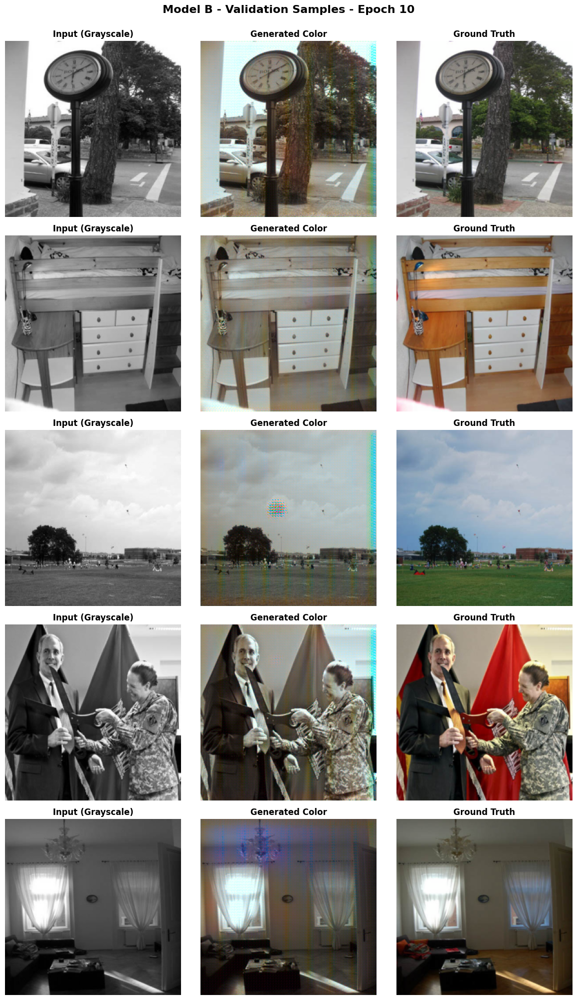

Epoch 11 [Train]: 100%|██████████| 75/75 [01:36<00:00,  1.29s/it, G_Loss=15.3266, D_Loss=0.0041]



Epoch 11/50
  Generator Loss: 14.5975
  Discriminator Loss: 0.0043
  Validation Loss: 0.1082


Epoch 12 [Train]: 100%|██████████| 75/75 [01:36<00:00,  1.29s/it, G_Loss=15.7603, D_Loss=0.0027]



Epoch 12/50
  Generator Loss: 15.2796
  Discriminator Loss: 0.0036
  Validation Loss: 0.0974


Epoch 13 [Train]: 100%|██████████| 75/75 [01:36<00:00,  1.29s/it, G_Loss=15.0453, D_Loss=0.0023]



Epoch 13/50
  Generator Loss: 15.7121
  Discriminator Loss: 0.0025
  Validation Loss: 0.0950


Epoch 14 [Train]: 100%|██████████| 75/75 [01:37<00:00,  1.29s/it, G_Loss=10.7450, D_Loss=0.5931]



Epoch 14/50
  Generator Loss: 13.3754
  Discriminator Loss: 0.3546
  Validation Loss: 0.1149


Epoch 15 [Train]: 100%|██████████| 75/75 [01:38<00:00,  1.31s/it, G_Loss=12.5100, D_Loss=0.3166]



Epoch 15/50
  Generator Loss: 10.9001
  Discriminator Loss: 0.5478
  Validation Loss: 0.1258


Epoch 16 [Train]: 100%|██████████| 75/75 [01:38<00:00,  1.32s/it, G_Loss=14.2964, D_Loss=0.5607]



Epoch 16/50
  Generator Loss: 11.1518
  Discriminator Loss: 0.5224
  Validation Loss: 0.1004


Epoch 17 [Train]: 100%|██████████| 75/75 [01:37<00:00,  1.30s/it, G_Loss=11.2799, D_Loss=0.9533]



Epoch 17/50
  Generator Loss: 12.1748
  Discriminator Loss: 0.3989
  Validation Loss: 0.1248


Epoch 18 [Train]: 100%|██████████| 75/75 [01:36<00:00,  1.28s/it, G_Loss=12.8317, D_Loss=0.0054]



Epoch 18/50
  Generator Loss: 13.8492
  Discriminator Loss: 0.0456
  Validation Loss: 0.0870
  ✓ New best model saved! (Val Loss: 0.0870)


Epoch 19 [Train]: 100%|██████████| 75/75 [01:36<00:00,  1.28s/it, G_Loss=13.9008, D_Loss=0.0032]



Epoch 19/50
  Generator Loss: 14.4129
  Discriminator Loss: 0.0058
  Validation Loss: 0.0861
  ✓ New best model saved! (Val Loss: 0.0861)


Epoch 20 [Train]: 100%|██████████| 75/75 [01:36<00:00,  1.29s/it, G_Loss=9.4876, D_Loss=0.5849] 



Epoch 20/50
  Generator Loss: 12.5518
  Discriminator Loss: 0.3460
  Validation Loss: 0.1038
  ✓ Checkpoint saved at epoch 20
  ✓ Validation samples saved to: val_samples_B_epoch_20.png


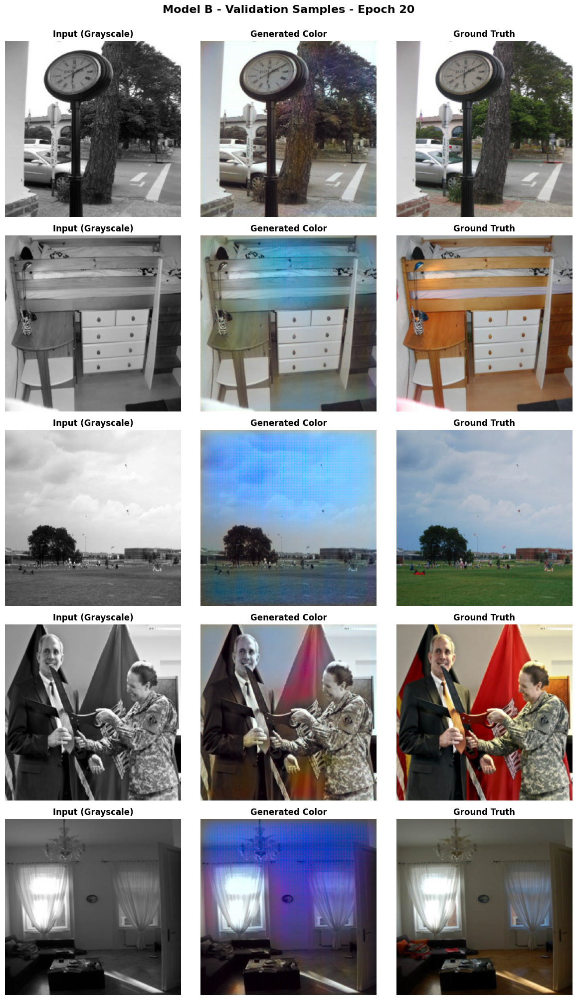

Epoch 21 [Train]: 100%|██████████| 75/75 [01:39<00:00,  1.32s/it, G_Loss=13.9082, D_Loss=0.0096]



Epoch 21/50
  Generator Loss: 13.3031
  Discriminator Loss: 0.2234
  Validation Loss: 0.1046


Epoch 22 [Train]: 100%|██████████| 75/75 [01:38<00:00,  1.31s/it, G_Loss=24.5854, D_Loss=0.0039]



Epoch 22/50
  Generator Loss: 15.0203
  Discriminator Loss: 0.0093
  Validation Loss: 0.1713


Epoch 23 [Train]: 100%|██████████| 75/75 [01:39<00:00,  1.33s/it, G_Loss=15.9772, D_Loss=0.0067]



Epoch 23/50
  Generator Loss: 15.0331
  Discriminator Loss: 0.0029
  Validation Loss: 0.1227


Epoch 24 [Train]: 100%|██████████| 75/75 [01:37<00:00,  1.30s/it, G_Loss=15.6461, D_Loss=0.0015]



Epoch 24/50
  Generator Loss: 14.9240
  Discriminator Loss: 0.0020
  Validation Loss: 0.0907


Epoch 25 [Train]: 100%|██████████| 75/75 [01:35<00:00,  1.28s/it, G_Loss=16.1327, D_Loss=0.0013]



Epoch 25/50
  Generator Loss: 15.1667
  Discriminator Loss: 0.0016
  Validation Loss: 0.0930


Epoch 26 [Train]: 100%|██████████| 75/75 [01:35<00:00,  1.28s/it, G_Loss=13.4083, D_Loss=0.0057]



Epoch 26/50
  Generator Loss: 15.2726
  Discriminator Loss: 0.0017
  Validation Loss: 0.0877


Epoch 27 [Train]: 100%|██████████| 75/75 [01:37<00:00,  1.30s/it, G_Loss=15.7714, D_Loss=0.0010]



Epoch 27/50
  Generator Loss: 15.6147
  Discriminator Loss: 0.0029
  Validation Loss: 0.0825
  ✓ New best model saved! (Val Loss: 0.0825)


Epoch 28 [Train]: 100%|██████████| 75/75 [01:37<00:00,  1.30s/it, G_Loss=15.0863, D_Loss=0.0071]



Epoch 28/50
  Generator Loss: 15.3240
  Discriminator Loss: 0.0032
  Validation Loss: 0.0964


Epoch 29 [Train]: 100%|██████████| 75/75 [01:36<00:00,  1.29s/it, G_Loss=11.4228, D_Loss=0.3775]



Epoch 29/50
  Generator Loss: 11.0498
  Discriminator Loss: 0.5976
  Validation Loss: 0.1374


Epoch 30 [Train]: 100%|██████████| 75/75 [01:37<00:00,  1.30s/it, G_Loss=9.4059, D_Loss=0.5601] 



Epoch 30/50
  Generator Loss: 11.3387
  Discriminator Loss: 0.4276
  Validation Loss: 0.0930
  ✓ Checkpoint saved at epoch 30
  ✓ Validation samples saved to: val_samples_B_epoch_30.png


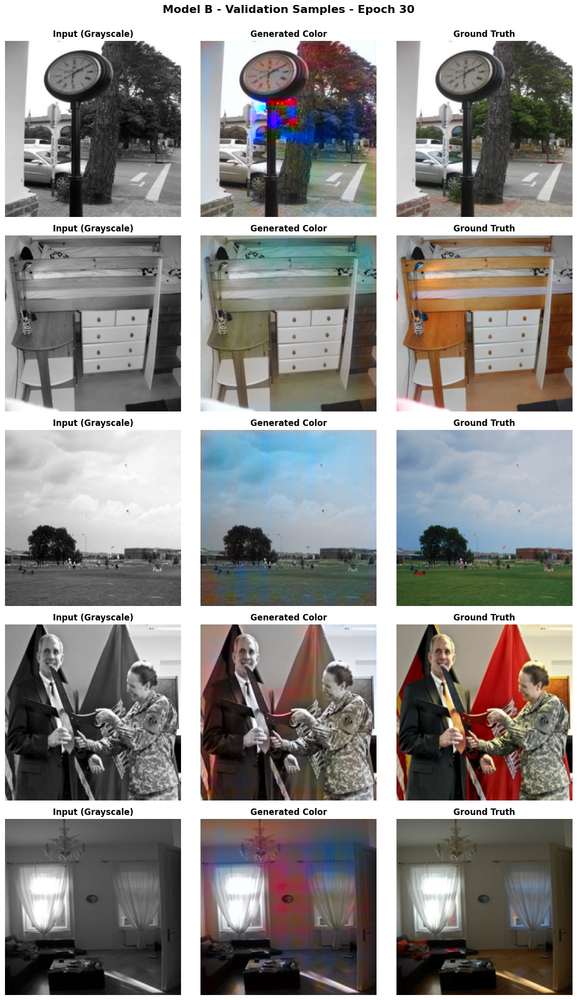

Epoch 31 [Train]: 100%|██████████| 75/75 [01:37<00:00,  1.30s/it, G_Loss=13.0338, D_Loss=0.0742]



Epoch 31/50
  Generator Loss: 11.7214
  Discriminator Loss: 0.3632
  Validation Loss: 0.1163


Epoch 32 [Train]: 100%|██████████| 75/75 [01:37<00:00,  1.30s/it, G_Loss=14.2388, D_Loss=0.0306]



Epoch 32/50
  Generator Loss: 13.6640
  Discriminator Loss: 0.1145
  Validation Loss: 0.1017


Epoch 33 [Train]: 100%|██████████| 75/75 [01:38<00:00,  1.32s/it, G_Loss=16.2379, D_Loss=0.0041]



Epoch 33/50
  Generator Loss: 14.1131
  Discriminator Loss: 0.0698
  Validation Loss: 0.1074


Epoch 34 [Train]: 100%|██████████| 75/75 [01:39<00:00,  1.33s/it, G_Loss=15.2506, D_Loss=0.0028]



Epoch 34/50
  Generator Loss: 14.7514
  Discriminator Loss: 0.0080
  Validation Loss: 0.0917


Epoch 35 [Train]: 100%|██████████| 75/75 [01:38<00:00,  1.32s/it, G_Loss=10.4136, D_Loss=0.2407]



Epoch 35/50
  Generator Loss: 14.3348
  Discriminator Loss: 0.2036
  Validation Loss: 0.1220


Epoch 36 [Train]: 100%|██████████| 75/75 [01:39<00:00,  1.32s/it, G_Loss=15.6423, D_Loss=0.0041]



Epoch 36/50
  Generator Loss: 12.9554
  Discriminator Loss: 0.1836
  Validation Loss: 0.0895


Epoch 37 [Train]: 100%|██████████| 75/75 [01:39<00:00,  1.32s/it, G_Loss=14.9137, D_Loss=0.0034]



Epoch 37/50
  Generator Loss: 14.0238
  Discriminator Loss: 0.0230
  Validation Loss: 0.0921


Epoch 38 [Train]: 100%|██████████| 75/75 [01:39<00:00,  1.32s/it, G_Loss=14.4395, D_Loss=0.0272]



Epoch 38/50
  Generator Loss: 14.6300
  Discriminator Loss: 0.0142
  Validation Loss: 0.0884


Epoch 39 [Train]: 100%|██████████| 75/75 [01:39<00:00,  1.32s/it, G_Loss=16.5360, D_Loss=0.0195]



Epoch 39/50
  Generator Loss: 14.8150
  Discriminator Loss: 0.0095
  Validation Loss: 0.0987


Epoch 40 [Train]: 100%|██████████| 75/75 [01:38<00:00,  1.31s/it, G_Loss=15.4353, D_Loss=0.0153]



Epoch 40/50
  Generator Loss: 14.8666
  Discriminator Loss: 0.0045
  Validation Loss: 0.0931
  ✓ Checkpoint saved at epoch 40
  ✓ Validation samples saved to: val_samples_B_epoch_40.png


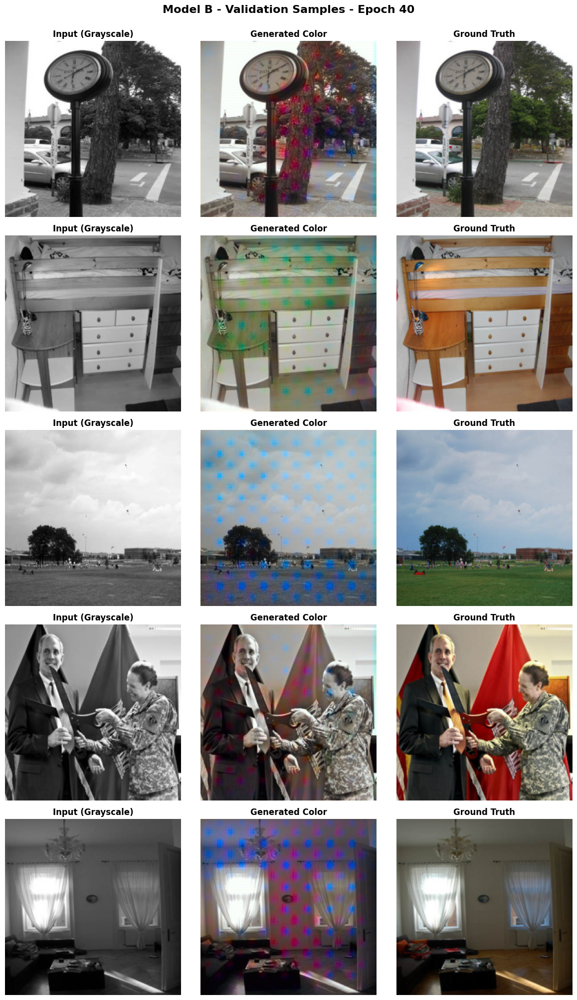

Epoch 41 [Train]: 100%|██████████| 75/75 [02:22<00:00,  1.90s/it, G_Loss=16.3304, D_Loss=0.0062]



Epoch 41/50
  Generator Loss: 14.4925
  Discriminator Loss: 0.1025
  Validation Loss: 0.1010


Epoch 42 [Train]: 100%|██████████| 75/75 [02:38<00:00,  2.12s/it, G_Loss=14.3231, D_Loss=0.2730]



Epoch 42/50
  Generator Loss: 14.1869
  Discriminator Loss: 0.1776
  Validation Loss: 0.1023


Epoch 43 [Train]: 100%|██████████| 75/75 [02:27<00:00,  1.97s/it, G_Loss=19.0355, D_Loss=0.0082]



Epoch 43/50
  Generator Loss: 13.8103
  Discriminator Loss: 0.1735
  Validation Loss: 0.1301


Epoch 44 [Train]: 100%|██████████| 75/75 [02:58<00:00,  2.37s/it, G_Loss=15.9581, D_Loss=0.0120]



Epoch 44/50
  Generator Loss: 14.9399
  Discriminator Loss: 0.0221
  Validation Loss: 0.0981


Epoch 45 [Train]: 100%|██████████| 75/75 [02:31<00:00,  2.02s/it, G_Loss=14.8658, D_Loss=0.0101]



Epoch 45/50
  Generator Loss: 14.5432
  Discriminator Loss: 0.0411
  Validation Loss: 0.0991


Epoch 46 [Train]: 100%|██████████| 75/75 [01:42<00:00,  1.36s/it, G_Loss=17.0166, D_Loss=0.0454]



Epoch 46/50
  Generator Loss: 14.2046
  Discriminator Loss: 0.0885
  Validation Loss: 0.1073


Epoch 47 [Train]: 100%|██████████| 75/75 [01:36<00:00,  1.28s/it, G_Loss=15.5889, D_Loss=0.1114]



Epoch 47/50
  Generator Loss: 12.9197
  Discriminator Loss: 0.2787
  Validation Loss: 0.1285


Epoch 48 [Train]: 100%|██████████| 75/75 [01:37<00:00,  1.30s/it, G_Loss=11.4396, D_Loss=0.1332]



Epoch 48/50
  Generator Loss: 11.4808
  Discriminator Loss: 0.3105
  Validation Loss: 0.1032


Epoch 49 [Train]: 100%|██████████| 75/75 [01:39<00:00,  1.32s/it, G_Loss=12.3925, D_Loss=0.2537]



Epoch 49/50
  Generator Loss: 10.7029
  Discriminator Loss: 0.3898
  Validation Loss: 0.1010


Epoch 50 [Train]: 100%|██████████| 75/75 [01:38<00:00,  1.32s/it, G_Loss=11.0413, D_Loss=0.3681]



Epoch 50/50
  Generator Loss: 10.0535
  Discriminator Loss: 0.4809
  Validation Loss: 0.0952
  ✓ Checkpoint saved at epoch 50
  ✓ Validation samples saved to: val_samples_B_epoch_50.png


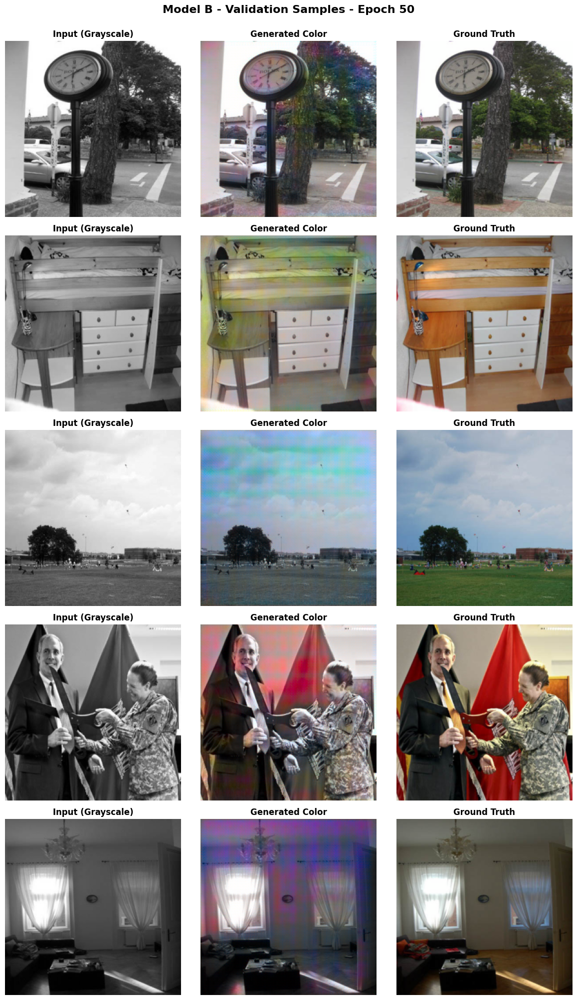


Training completed!
Best Validation Loss: 0.0825
Training history saved to: ..\results\B\training_history_B.csv



In [11]:
# Train model
best_val_loss = float("inf")

print(f"\n{'=' * 60}")
print(f"Starting Training - Model {MODEL_ID}")
print(f"{'=' * 60}\n")

for epoch in range(1, EPOCHS + 1):
    # Train
    avg_gen_loss, avg_disc_loss = train_epoch(
        generator, discriminator, train_loader, optimizer_G, optimizer_D, epoch, device
    )

    # Validate
    avg_val_loss = validate_epoch(generator, val_loader, device)

    # Update history
    history["epoch"].append(epoch)
    history["train_loss"].append(avg_gen_loss)
    history["val_loss"].append(avg_val_loss)
    history["gen_loss"].append(avg_gen_loss)
    
    if USE_GAN:
        history["disc_loss"].append(avg_disc_loss)

    print(f"\nEpoch {epoch}/{EPOCHS}")
    print(f"  Generator Loss: {avg_gen_loss:.4f}")
    if USE_GAN:
        print(f"  Discriminator Loss: {avg_disc_loss:.4f}")
    print(f"  Validation Loss: {avg_val_loss:.4f}")

    # Save best model based on validation loss
    if avg_val_loss < best_val_loss:
        best_val_loss = avg_val_loss
        checkpoint = {
            "epoch": epoch,
            "model_id": MODEL_ID,
            "generator_state_dict": generator.state_dict(),
            "optimizer_G_state_dict": optimizer_G.state_dict(),
            "history": history,
            "best_val_loss": best_val_loss,
            "best_train_loss": avg_gen_loss,
            "config": config,
        }
        
        if USE_GAN:
            checkpoint["discriminator_state_dict"] = discriminator.state_dict()
            checkpoint["optimizer_D_state_dict"] = optimizer_D.state_dict()
        
        torch.save(checkpoint, save_dir / "best_model.pt")
        print(f"  ✓ New best model saved! (Val Loss: {best_val_loss:.4f})")

    # Save checkpoint at intervals
    if epoch % SAVE_INTERVAL == 0:
        checkpoint_path = save_dir / f"checkpoint_epoch_{epoch}.pt"
        torch.save(checkpoint, checkpoint_path)
        print(f"  ✓ Checkpoint saved at epoch {epoch}")

        # Visualize validation samples
        visualize_validation_samples(generator, val_loader, device, epoch, results_dir)

    # Save training history to CSV after each epoch
    history_df = pd.DataFrame(history)
    history_csv_path = results_dir / f"training_history_{MODEL_ID}.csv"
    history_df.to_csv(history_csv_path, index=False)

    # Step learning rate schedulers
    scheduler_G.step()
    if scheduler_D is not None:
        scheduler_D.step()

    # Clear cache
    if torch.cuda.is_available():
        torch.cuda.empty_cache()

print(f"\n{'=' * 60}")
print("Training completed!")
print(f"Best Validation Loss: {best_val_loss:.4f}")
print(f"Training history saved to: {history_csv_path}")
print(f"{'=' * 60}\n")


## Evaluation on Test Set

After training (and optionally reloading the best-performing checkpoint), the model is evaluated on the **test set** using multiple complementary metrics.

Evaluation is performed by iterating over `test_loader`, converting both predicted and ground-truth Lab images back to RGB, and then computing the following metrics for each batch:

1. **Peak Signal-to-Noise Ratio (PSNR)**  
2. **Structural Similarity Index Measure (SSIM)**  
3. **CIEDE2000 color difference ($\Delta E_{00}$)**  
4. **LPIPS (Learned Perceptual Image Patch Similarity)**  

The mean of each metric across all test images is reported.

---

### 1. Peak Signal-to-Noise Ratio (PSNR)

Given a ground-truth RGB image $x$ and a predicted RGB image $\hat{x}$ in $[0, 1]$, the mean squared error (MSE) is:

$$
\mathrm{MSE}(x, \hat{x}) =
\frac{1}{N} \sum_{i=1}^{N} (x_i - \hat{x}_i)^2,
$$

where $N$ is the number of pixel-channel elements.

The PSNR (in decibels) is then defined as:

$$
\mathrm{PSNR}(x, \hat{x}) =
10 \log_{10} \left(\frac{MAX_I^2}{\mathrm{MSE}(x, \hat{x})}\right),
$$

with $MAX_I = 1$ for images in $[0, 1]$.

In the code:

- PSNR is computed per image using `peak_signal_noise_ratio` from `skimage.metrics` with `data_range=1.0`.
- The metric is averaged over all images in the batch, and then over all test batches.

---

### 2. Structural Similarity Index (SSIM)

SSIM measures perceptual similarity between two images in terms of luminance, contrast, and structural information.

For local patches of images $x$ and $y$, with means $\mu_x, \mu_y$, variances $\sigma_x^2, \sigma_y^2$, and covariance $\sigma_{xy}$, SSIM is given by:

$$
\mathrm{SSIM}(x, y)
= \frac{(2\mu_x \mu_y + C_1)(2\sigma_{xy} + C_2)}
       {(\mu_x^2 + \mu_y^2 + C_1)(\sigma_x^2 + \sigma_y^2 + C_2)},
$$

where $C_1$ and $C_2$ are small constants for numerical stability.

In the implementation:

- SSIM is computed on RGB images using `structural_similarity` from `skimage.metrics`.
- `data_range=1.0` (since RGB values lie in $[0, 1]$).
- `channel_axis=2` is used so channels are treated correctly.

The mean SSIM over the test set reflects the structural fidelity of the generated color images.

---

### 3. CIEDE2000 Color Difference ($\Delta E_{00}$)

CIEDE2000 is a perceptually motivated metric to quantify color differences in the CIE Lab space.

Steps used in the evaluation:

1. Convert normalized predictions and targets back to Lab:
   - Luminance:
     $$
     L^* = (L_{\text{norm}} + 1.0) \times 50.0,
     $$
   - Chrominance:
     $$
     a^* = a_{\text{norm}} \times 128.0, \quad
     b^* = b_{\text{norm}} \times 128.0.
     $$

2. For each image, sample pixels at a fixed stride (e.g. every 8th pixel in height and width) to limit computational cost while preserving representativeness.

3. Construct `LabColor` objects for predicted and ground-truth colors and compute per-pixel $\Delta E_{00}$ via:
   ```python
   delta_e_cie2000(lab_true, lab_pred)
   ```

4. Average the color differences:

   * First across all sampled pixels in an image,
   * Then across all test images.

A lower mean $\Delta E_{00}$ indicates that the generated colors are closer to the ground truth in a perceptually uniform sense.

---

### 4. LPIPS (Learned Perceptual Image Patch Similarity)

LPIPS is a learned perceptual metric based on deep network features. In this notebook, an AlexNet-based LPIPS model is used:

```python
lpips_model = lpips.LPIPS(net="alex").to(device)
lpips_model.eval()
```

Conceptually, LPIPS can be expressed as:

$$
\mathrm{LPIPS}(x, \hat{x})
= \sum_{l} \frac{1}{H_l W_l}
\left| w_l \odot \left( \phi_l(x) - \phi_l(\hat{x}) \right) \right|_2^2,
$$

where:

* $\phi_l(\cdot)$ denotes feature maps extracted at layer $l$,
* $H_l, W_l$ are spatial dimensions of the feature maps,
* $w_l$ are learned weights,
* $\odot$ denotes element-wise multiplication.

In practice:

1. RGB images (from Lab→RGB conversion) are converted to tensors and rescaled to $[-1, 1]$ as expected by the LPIPS model.
2. `lpips_model(pred, target)` returns patch-wise distances, which are then averaged over spatial dimensions and batch elements.

A lower LPIPS score indicates that generated images are more perceptually similar to the ground truth.

---

### Metric Aggregation Over the Test Set

For each test batch:

1. Predictions are generated by:

   ```python
   ab_pred = generator(L.to(device)).cpu().numpy()
   ```
2. Predictions and ground truth are converted to RGB using the NumPy-based Lab→RGB helper.
3. PSNR, SSIM, CIEDE2000, and LPIPS are computed and accumulated.

After processing all batches:

* The sum of each metric is divided by the total number of evaluated images to obtain:

  * Mean PSNR,
  * Mean SSIM,
  * Mean CIEDE2000,
  * Mean LPIPS.

These aggregated values are printed and later stored for comparison between different model configurations, providing a **comprehensive quantitative assessment** of colorization quality on unseen data.


In [12]:
# Patch numpy for colormath compatibility
if not hasattr(np, "asscalar"):
    np.asscalar = lambda x: x.item() if hasattr(x, "item") else float(x)


# Evaluation metrics class
class ColorimetricEvaluator:
    def __init__(self, device):
        self.device = device
        self.lpips_model = lpips.LPIPS(net="alex").to(device)
        self.lpips_model.eval()

    def calculate_psnr(self, L, ab_generated, ab_target):
        """Calculate PSNR on RGB images (standard for image restoration)"""
        # Convert to RGB numpy arrays (Range 0-1)
        rgb_gen = lab_to_rgb_numpy(L, ab_generated)
        rgb_target = lab_to_rgb_numpy(L, ab_target)
        
        psnr_values = []
        for i in range(rgb_gen.shape[0]):
            # Calculate PSNR on RGB images
            # data_range must be 1.0 because lab_to_rgb_numpy returns [0,1]
            psnr = peak_signal_noise_ratio(rgb_target[i], rgb_gen[i], data_range=1.0)
            psnr_values.append(psnr)
        return np.mean(psnr_values)

    def calculate_ssim(self, L, ab_generated, ab_target):
        """Calculate SSIM on RGB images (not ab channels which lack structure)"""
        # Convert to RGB numpy arrays (Range 0-1)
        rgb_gen = lab_to_rgb_numpy(L, ab_generated)
        rgb_target = lab_to_rgb_numpy(L, ab_target)
        
        ssim_values = []
        for i in range(rgb_gen.shape[0]):
            # Calculate SSIM on RGB images
            # data_range must be 1.0 because lab_to_rgb_numpy returns [0,1]
            ssim = structural_similarity(
                rgb_target[i], 
                rgb_gen[i], 
                data_range=1.0, 
                channel_axis=2
            )
            ssim_values.append(ssim)
        return np.mean(ssim_values)

    def calculate_ciede2000(self, L, ab_generated, ab_target):
        """Calculate CIEDE2000 color difference metric"""
        L_np = (L.cpu().numpy() + 1.0) * 50.0
        ab_gen_np = ab_generated.cpu().numpy() * 128.0
        ab_target_np = ab_target.cpu().numpy() * 128.0

        delta_e_values = []
        for b in range(L_np.shape[0]):
            L_channel = L_np[b, 0]
            # Changed from step=8 for sampling to reduce computation time and still get good estimate
            step = 8
            sample_indices = [
                (i, j)
                for i in range(0, L_channel.shape[0], step)
                for j in range(0, L_channel.shape[1], step)
            ]

            pixel_deltas = []
            for i, j in sample_indices:
                lab_gen = LabColor(L_channel[i, j], ab_gen_np[b, 0, i, j], ab_gen_np[b, 1, i, j])
                lab_target = LabColor(
                    L_channel[i, j], ab_target_np[b, 0, i, j], ab_target_np[b, 1, i, j]
                )
                delta_e = delta_e_cie2000(lab_gen, lab_target)
                pixel_deltas.append(delta_e)

            delta_e_values.append(np.mean(pixel_deltas))
        return np.mean(delta_e_values)

    def calculate_lpips(self, L, ab_generated, ab_target):
        with torch.no_grad():
            # Use numpy conversion for accurate color space transformation
            rgb_gen_np = lab_to_rgb_numpy(L, ab_generated)
            rgb_target_np = lab_to_rgb_numpy(L, ab_target)

            # Convert to tensor for LPIPS (expects range [-1, 1])
            rgb_gen_tensor = (
                torch.from_numpy(rgb_gen_np).permute(0, 3, 1, 2).float() * 2 - 1
            ).to(self.device)
            rgb_target_tensor = (
                torch.from_numpy(rgb_target_np).permute(0, 3, 1, 2).float() * 2 - 1
            ).to(self.device)

            lpips_value = self.lpips_model(rgb_gen_tensor, rgb_target_tensor)
            return lpips_value.mean().item()

    def evaluate_batch(self, L, ab_generated, ab_target):
        """Evaluate batch with all metrics - now passing L to PSNR and SSIM for RGB conversion"""
        metrics = {
            "PSNR": self.calculate_psnr(L, ab_generated, ab_target),
            "SSIM": self.calculate_ssim(L, ab_generated, ab_target),
            "CIEDE2000": self.calculate_ciede2000(L, ab_generated, ab_target),
            "LPIPS": self.calculate_lpips(L, ab_generated, ab_target),
        }
        return metrics


evaluator = ColorimetricEvaluator(device)
print("Evaluator initialized")


Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


c:\Users\USER\Documents\Dechathon_N\AIT\Computer Vision\Colorized-Image-Project\.venv\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\USER\Documents\Dechathon_N\AIT\Computer Vision\Colorized-Image-Project\.venv\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: c:\Users\USER\Documents\Dechathon_N\AIT\Computer Vision\Colorized-Image-Project\.venv\Lib\site-packages\lpips\weights\v0.1\alex.pth
Evaluator initialized


In [13]:
# Evaluate on test set
generator.eval()

metrics_sum = {"PSNR": 0.0, "SSIM": 0.0, "CIEDE2000": 0.0, "LPIPS": 0.0}
num_evaluated = 0

print(f"Evaluating Model {MODEL_ID} on test set...")
with torch.no_grad():
    for L, ab_real, _ in tqdm(test_loader, desc="Evaluating"):
        L = L.to(device)
        ab_real = ab_real.to(device)

        ab_fake = generator(L)
        batch_metrics = evaluator.evaluate_batch(L, ab_fake, ab_real)

        for key in metrics_sum:
            metrics_sum[key] += batch_metrics[key]

        num_evaluated += 1

# Average metrics
metrics_avg = {key: val / num_evaluated for key, val in metrics_sum.items()}

print(f"\n{'=' * 60}")
print(f"Model {MODEL_ID} Evaluation Results:")
print(f"{'=' * 60}")
print(f"PSNR:        {metrics_avg['PSNR']:.4f} dB")
print(f"SSIM:        {metrics_avg['SSIM']:.4f}")
print(f"CIEDE2000:   {metrics_avg['CIEDE2000']:.4f}")
print(f"LPIPS:       {metrics_avg['LPIPS']:.4f}")
print(f"{'=' * 60}\n")


Evaluating Model B on test set...


Evaluating: 100%|██████████| 12/12 [01:32<00:00,  7.69s/it]


Model B Evaluation Results:
PSNR:        20.8273 dB
SSIM:        0.8298
CIEDE2000:   13.7505
LPIPS:       0.2715



## Save Results

This section serializes the **experimental configuration** and **evaluation metrics** to disk so that results from different runs can be compared in a structured way.

### Metrics Aggregation

After evaluation on the test set, the following quantities are available:

- `psnr_avg` – mean PSNR over the test set,
- `ssim_avg` – mean SSIM over the test set,
- `ciede2000_avg` – mean CIEDE2000 color difference,
- `lpips_avg` – mean LPIPS perceptual distance,
- `best_val_loss` – best (minimum) validation $L_1$ loss observed during training.

A `pandas.DataFrame` is constructed to summarize the current experiment, typically with one row containing:

- **Configuration fields**
  - `Model_ID` – value of `MODEL_ID`,
  - `Description` – textual description from `MODEL_CONFIGS[MODEL_ID]["description"]`,
  - `Architecture` – here, “U-Net” (generator backbone),
  - `GAN` – whether `USE_GAN` is `True` or `False`,
  - `L1_Loss` – whether `USE_L1` is `True` or `False`,
  - `Perceptual_Loss` – whether `USE_PERCEPTUAL` is `True` or `False`,
  - `Lambda_L1` – value of `LAMBDA_L1`,
  - `Lambda_Perceptual` – value of `LAMBDA_PERCEPTUAL`.

- **Test-set metrics**
  - `PSNR` – mean PSNR (dB),
  - `SSIM` – mean SSIM,
  - `CIEDE2000` – mean $\Delta E_{00}$,
  - `LPIPS` – mean LPIPS.

- **Training information**
  - `Best_Val_Loss` – best validation loss,
  - `Epochs` – total number of training epochs.

This DataFrame is then saved as a CSV file in the results directory, for example:

```python
metrics_path = results_dir / f"metrics_{MODEL_ID}.csv"
metrics_df.to_csv(metrics_path, index=False)
```

The resulting CSV serves as a **compact, machine-readable summary** of the experiment.

### Directory Structure

Two main directories are used to organize outputs:

* **Model directory**

  ```text
  ../models/<MODEL_ID>/
  ```

  Contains:

  * `best_model.pt` (best generator checkpoint),
  * Optional intermediate checkpoints (e.g. per `SAVE_INTERVAL` epochs).

* **Results directory**

  ```text
  ../results/<MODEL_ID>/
  ```

  Contains:

  * `training_history_<MODEL_ID>.csv` (logged per-epoch losses, written during training),
  * `metrics_<MODEL_ID>.csv` (summary table written in this cell),
  * Plots and visualizations generated elsewhere (e.g. loss curves, qualitative colorization results).

By maintaining this structure, each experiment run associated with a particular `MODEL_ID` is **fully documented**, making it straightforward to:

* Compare multiple configurations,
* Integrate results into reports,
* Reproduce and audit experimental findings.

✓ Metrics saved to: ..\results\B\metrics_B.csv
✓ Training plot saved to: ..\results\B\training_history_B.png


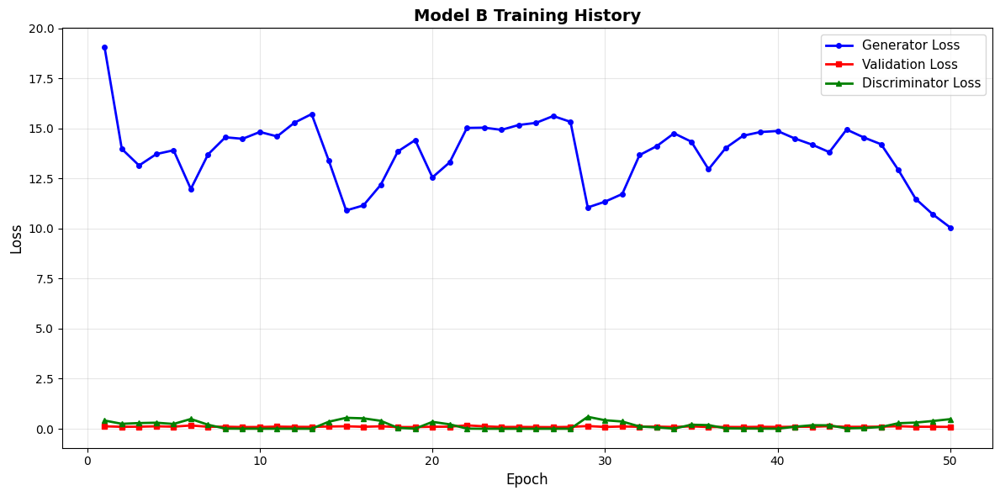

In [14]:
# Save metrics to CSV
metrics_df = pd.DataFrame([
    {
        "Model_ID": MODEL_ID,
        "Description": config["description"],
        "Architecture": "U-Net",
        "GAN": USE_GAN,
        "L1_Loss": USE_L1,
        "Perceptual_Loss": USE_PERCEPTUAL,
        "Lambda_L1": LAMBDA_L1,
        "Lambda_Perceptual": LAMBDA_PERCEPTUAL,
        "PSNR": metrics_avg["PSNR"],
        "SSIM": metrics_avg["SSIM"],
        "CIEDE2000": metrics_avg["CIEDE2000"],
        "LPIPS": metrics_avg["LPIPS"],
        "Best_Val_Loss": best_val_loss,
        "Epochs": EPOCHS,
    }
])

csv_path = results_dir / f"metrics_{MODEL_ID}.csv"
metrics_df.to_csv(csv_path, index=False)
print(f"✓ Metrics saved to: {csv_path}")

# Save training history plot
plt.figure(figsize=(12, 6))
plt.plot(
    history["epoch"],
    history["gen_loss"],
    "b-",
    linewidth=2,
    label="Generator Loss",
    marker="o",
    markersize=4,
)
plt.plot(
    history["epoch"],
    history["val_loss"],
    "r-",
    linewidth=2,
    label="Validation Loss",
    marker="s",
    markersize=4,
)
if USE_GAN:
    plt.plot(
        history["epoch"],
        history["disc_loss"],
        "g-",
        linewidth=2,
        label="Discriminator Loss",
        marker="^",
        markersize=4,
    )
plt.xlabel("Epoch", fontsize=12)
plt.ylabel("Loss", fontsize=12)
plt.title(f"Model {MODEL_ID} Training History", fontsize=14, fontweight="bold")
plt.grid(True, alpha=0.3)
plt.legend(fontsize=11)
plt.tight_layout()

plot_path = results_dir / f"training_history_{MODEL_ID}.png"
plt.savefig(plot_path, dpi=150, bbox_inches="tight")
print(f"✓ Training plot saved to: {plot_path}")
plt.show()


## Visualize Results

This section produces **qualitative visualizations** of the model’s colorization performance on the test set.

### Visualization Procedure

The visualization code performs the following steps:

1. **Evaluation mode and no gradients**

   The generator is put into evaluation mode and gradient computation is disabled:

   ```python
   generator.eval()
   with torch.no_grad():
       ...
       ```

This ensures that:

* BatchNorm and dropout layers (if any) behave deterministically,
* No gradients are stored, reducing memory usage during visualization.

2. **Sampling test images**

   A single batch is drawn from `test_loader`, and only a limited number of samples (e.g. `num_samples = 5`) are used for visualization:

   ```python
   L, ab_real, gray_imgs = next(iter(test_loader))
   L = L[:num_samples].to(device)
   ab_real = ab_real[:num_samples].to(device)
   gray_imgs = gray_imgs[:num_samples]
   ```

3. **Generating predictions**

   The generator produces chrominance predictions:

   ```python
   ab_pred = generator(L).cpu()
   L_cpu = L.cpu()
   ```

   Here:

   * `L_cpu` – normalized luminance inputs,
   * `ab_pred` – normalized predicted chrominance channels.

4. **Conversion from Lab to RGB**

   For both predicted and ground-truth images, Lab values are denormalized and converted to RGB:

   * Denormalization:
     $$
     L^* = (L_{\text{norm}} + 1.0) \times 50.0,
     $$
     $$
     a^* = a_{\text{norm}} \times 128.0, \quad
     b^* = b_{\text{norm}} \times 128.0.
     $$

   * Stacking into a Lab image and applying `lab2rgb`:

     ```python
     lab_pred = np.stack([L_star, a_star_pred, b_star_pred], axis=-1)
     rgb_pred = lab2rgb(lab_pred)

     lab_real = np.stack([L_star, a_star_real, b_star_real], axis=-1)
     rgb_real = lab2rgb(lab_real)
     ```

   This yields:

   * `rgb_pred` – predicted color images,
   * `rgb_real` – ground-truth color images.

### Figure Layout

A figure is created using `matplotlib` with **three columns** per sample:

1. **Input (Grayscale)**

   * Displayed using the grayscale tensor `gray_imgs[i]`.
   * Represents the luminance-only input that the model receives.

2. **Generated Colorization**

   * The RGB image reconstructed from $L^*$ and $\hat{a}^*, \hat{b}^*$.
   * Provides a direct visual impression of the model’s output.

3. **Ground-Truth Color Image**

   * The RGB image reconstructed from $L^*$ and true $a^*, b^*$.
   * Serves as the visual reference for comparison.

For each row $i$ (each selected test image):

* Column 1:

  ```python
  plt.imshow(gray_imgs[i].squeeze(), cmap="gray")
  plt.title("Input (Grayscale)")
  ```

* Column 2:

  ```python
  plt.imshow(rgb_pred_i)
  plt.title("Generated Color")
  ```

* Column 3:

  ```python
  plt.imshow(rgb_real_i)
  plt.title("Ground Truth")
  ```

Axis ticks are typically removed for clarity.

### Saving the Visualization

The final grid of results is saved to the results directory, for example:

```python
output_path = results_dir / f"colorization_results_{MODEL_ID}.png"
plt.savefig(output_path, bbox_inches="tight")
plt.close()
```

The cell then prints a short summary indicating:

* The `MODEL_ID` used,
* The model directory (`../models/<MODEL_ID>/`),
* The results directory (`../results/<MODEL_ID>/`),
* The filename of the saved visualization image.

---

These qualitative visualizations complement the **quantitative metrics** (PSNR, SSIM, CIEDE2000, LPIPS) and the **training history plots**, providing a complete, project-style presentation of the model’s behavior on unseen test images.


✓ Visualization saved to: ..\results\B\colorization_results_B.png


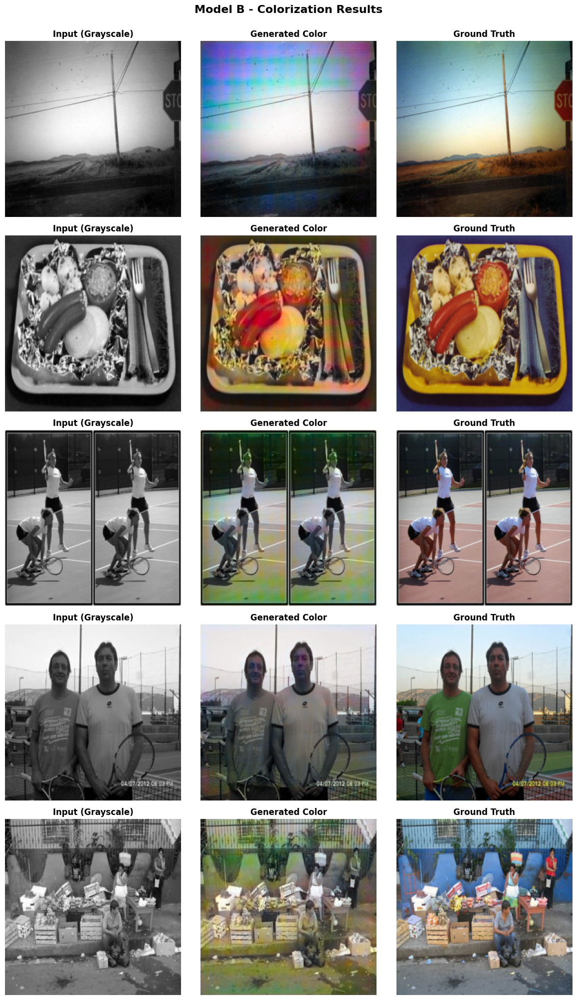


Model B - Training and Evaluation Complete!
Models saved in: ..\models\B
Results saved in: ..\results\B


In [15]:
# Visualize and save sample results
generator.eval()
num_samples = 5

with torch.no_grad():
    L, ab_real, gray_img = next(iter(test_loader))
    L = L[:num_samples].to(device)
    ab_real = ab_real[:num_samples]
    gray_img = gray_img[:num_samples]

    ab_fake = generator(L).cpu()
    L = L.cpu()

    fig, axes = plt.subplots(num_samples, 3, figsize=(12, 4 * num_samples))

    for i in range(num_samples):
        # Grayscale input
        axes[i, 0].imshow(gray_img[i].squeeze(), cmap="gray")
        axes[i, 0].set_title("Input (Grayscale)", fontweight="bold")
        axes[i, 0].axis("off")

        # Generated colorization
        L_np = (L[i].squeeze().numpy() + 1.0) * 50.0
        ab_fake_np = ab_fake[i].permute(1, 2, 0).numpy() * 128.0
        lab_fake = np.zeros((IMG_SIZE, IMG_SIZE, 3))
        lab_fake[:, :, 0] = L_np
        lab_fake[:, :, 1:] = ab_fake_np
        rgb_fake = lab2rgb(lab_fake)

        axes[i, 1].imshow(rgb_fake)
        axes[i, 1].set_title("Generated Color", fontweight="bold")
        axes[i, 1].axis("off")

        # Ground truth
        ab_real_np = ab_real[i].permute(1, 2, 0).numpy() * 128.0
        lab_real = np.zeros((IMG_SIZE, IMG_SIZE, 3))
        lab_real[:, :, 0] = L_np
        lab_real[:, :, 1:] = ab_real_np
        rgb_real = lab2rgb(lab_real)

        axes[i, 2].imshow(rgb_real)
        axes[i, 2].set_title("Ground Truth", fontweight="bold")
        axes[i, 2].axis("off")

    plt.suptitle(f"Model {MODEL_ID} - Colorization Results", fontsize=16, fontweight="bold", y=1.0)
    plt.tight_layout()

    output_path = results_dir / f"colorization_results_{MODEL_ID}.png"
    plt.savefig(output_path, dpi=150, bbox_inches="tight")
    print(f"✓ Visualization saved to: {output_path}")

    plt.show()

print(f"\n{'=' * 60}")
print(f"Model {MODEL_ID} - Training and Evaluation Complete!")
print(f"{'=' * 60}")
print(f"Models saved in: {save_dir}")
print(f"Results saved in: {results_dir}")
print(f"{'=' * 60}")
